<a href="https://colab.research.google.com/github/Oleksy1121/Car-damage-detection/blob/main/training/YOLOv8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installation and Initial Setup
The script installs and configures the YOLO (You Only Look Once) library for object detection tasks. Additionally, it imports the necessary libraries for image processing and result visualization.

In [ ]:
# Install neccesary libraries
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 22.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 124.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 107.3 MB/s eta 0:00:00


In [ ]:
# Import the YOLO library and other necessary libraries
from ultralytics import YOLO
import os
from IPython.display import display, Image
import yaml
import cv2
import matplotlib.pyplot as plt
import random
import matplotlib.patches as patches
from PIL import Image as PILImage
import cv2
import glob
import numpy as np

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Data Downloading and Preparation

The script downloads a dataset from Roboflow, unpacks it, and then modifies the paths to the training, validation, and test sets in the YAML file to match the local disk locations.

In [ ]:
# Download the dataset and unzip it
  !curl -L "https://app.roboflow.com/ds/t6xM6xE9bF?key=ym8EYKP9vQ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   904  100   904    0     0   3064      0 --:--:-- --:--:-- --:--:--  3074
100 17.3M  100 17.3M    0     0  13.3M      0  0:00:01  0:00:01 --:--:-- 47.0M
Archive:  roboflow.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
  inflating: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/07-is-250-came-to-my-car-saw-a-big-crack-in-the-rear-v0-epzwgdws1iaa1_webp.rf.f8fa8c1e25c320516c8be752fc2c6fbe.jpg  
 extracting: test/images/073_jpg.rf.9fb7792655a0d1aeb80a19d88d2216c2.jpg  
 extracting: test/images/077_jpg.rf.27e0ff0931694f718ff9ce851b1a7ae9.jpg  
 extracting: test/images/1150_jpg.rf.e2a4e07bcca74f8c0a698a4181be1d18.jpg  
 extracting: test/images/116260-IMG_9532_JPG_jpg.rf.ca2bf7ea5490c16f6a5284e5640de9e3.jpg  
 extracting: test/images/20240608_211701_jp

In [ ]:
# Path to the data YAML file
data_yaml = "/content/data.yaml"

# Open and read data from the YAML file
with open(data_yaml, 'r') as file:
    data = yaml.safe_load(file)

# Modify values for train, validation, and test datasets
data['train'] = "/content/train/images"
data['val'] = "/content/valid/images"
data['test'] = "/content/test/images"

# Save the modified data back to the YAML file
with open(data_yaml, 'w') as file:
    yaml.dump(data, file)

# Loading and Visualizing Annotations
The script defines functions to load class names and their colors from a YAML file, and then displays images with annotations, which can be in the form of YOLO bounding boxes or polygons.

In [ ]:
# Load and visualize annotations

def load_class_names_and_colors(yaml_path):
    # Load class names and define colors for each class from a YAML file
    with open(yaml_path, 'r') as file:
        data = yaml.safe_load(file)
    names = data['names']
    colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'aqua', 'grey']  # Define colors for classes
    return names, dict(zip(names, colors))

def display_images_with_annotations(image_folder_path, num_images=8, yaml_path=data_yaml):
    # Display images with annotations
    class_names, class_colors = load_class_names_and_colors(yaml_path)
    annotations_folder_path = image_folder_path.replace('/images', '/labels')
    image_files = [f for f in os.listdir(image_folder_path) if f.endswith('.jpg')]

    # Check if there are enough images to display
    if len(image_files) < num_images:
        print("Not enough images available.")
        num_images = len(image_files)
        if num_images == 0:
            print("No images to display.")
            return  # Exit function if no images are available

    random.shuffle(image_files)

    fig, axs = plt.subplots(1, num_images, figsize=(5 * num_images, 5))
    for i, file in enumerate(image_files[:num_images]):
        img_path = os.path.join(image_folder_path, file)
        ann_path = os.path.join(annotations_folder_path, file.replace('.jpg', '.txt'))
        img = PILImage.open(img_path)
        axs[i].imshow(img)
        axs[i].axis('off')

        draw_annotations(axs[i], ann_path, img.size, class_names, class_colors)

    plt.show()

def draw_annotations(ax, annotation_path, image_size, class_names, class_colors):
    # Draw annotations on an image
    with open(annotation_path, 'r') as file:
        for line in file:
            parts = line.strip().split()
            class_id = int(parts[0])
            class_name = class_names[class_id]
            color = class_colors[class_name]
            if len(parts) == 5:  # YOLO bounding boxes
                draw_yolo_bbox(ax, parts, image_size, class_name, color)
            else:  # Polygon coordinates
                draw_polygon(ax, parts, image_size, class_name, color)

def draw_yolo_bbox(ax, parts, image_size, class_name, color):
    # Draw YOLO format bounding box
    x_center = float(parts[1]) * image_size[0]
    y_center = float(parts[2]) * image_size[1]
    width = float(parts[3]) * image_size[0]
    height = float(parts[4]) * image_size[1]
    x_min = x_center - width / 2
    y_min = y_center - height / 2
    rect = patches.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(rect)
    ax.text(x_min, y_min - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

def draw_polygon(ax, parts, image_size, class_name, color):
    # Draw polygon annotation
    points = list(map(float, parts[1:]))
    polygon = [(points[i] * image_size[0], points[i + 1] * image_size[1]) for i in range(0, len(points), 2)]
    poly_shape = patches.Polygon(polygon, linewidth=2, edgecolor=color, facecolor='none')
    ax.add_patch(poly_shape)
    ax.text(polygon[0][0], polygon[0][1] - 10, class_name, color='white', fontsize=12, backgroundcolor=color)

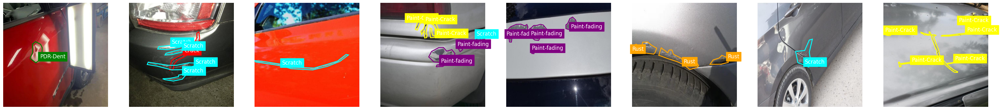

In [ ]:
# Example function call
display_images_with_annotations(data['train'])

# Training the YOLOv8 Model
The script trains a YOLOv8 model based on the provided YAML configuration file.

In [ ]:
# Train the YOLOv8 model with specified parameters
!yolo task=detect mode=train model=yolov8m.pt data="/content/data.yaml" epochs = 100 imgsz = 640 batch = -1

100% 49.7M/49.7M [00:00<00:00, 300MB/s]
Ultralytics 8.3.161 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=-1, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=100, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8m.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, pl

Wyniki trenowania modelu

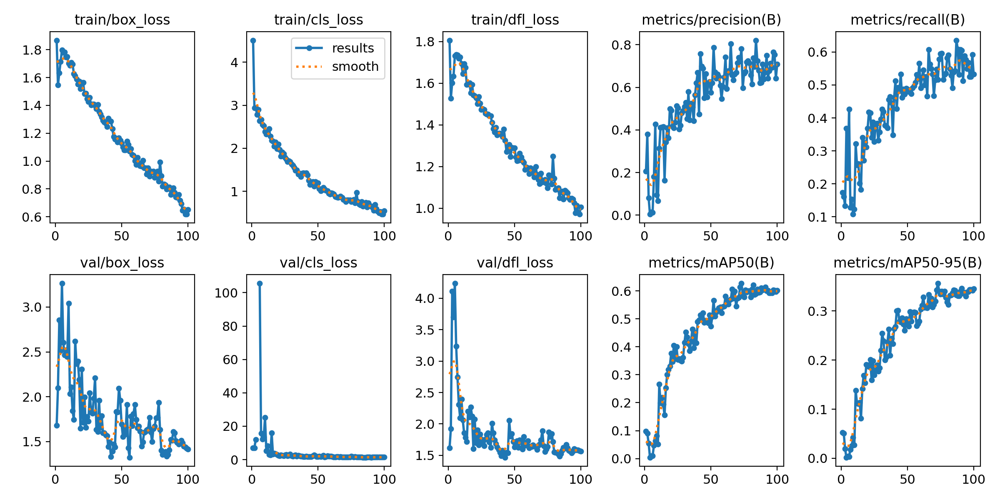

In [ ]:
# Display training results image
display(Image(filename='/content/runs/detect/train/results.png'))

In [ ]:
import os
print(os.listdir("/content/runs/detect/train"))


['weights', 'val_batch0_labels.jpg', 'train_batch0.jpg', 'F1_curve.png', 'val_batch2_labels.jpg', 'results.csv', 'train_batch1890.jpg', 'train_batch1892.jpg', 'args.yaml', 'labels_correlogram.jpg', 'confusion_matrix_normalized.png', 'train_batch2.jpg', 'val_batch1_pred.jpg', 'P_curve.png', 'R_curve.png', 'train_batch1.jpg', 'confusion_matrix.png', 'labels.jpg', 'results.png', 'val_batch0_pred.jpg', 'PR_curve.png', 'val_batch1_labels.jpg', 'train_batch1891.jpg', 'val_batch2_pred.jpg']


Macierz pomyłek

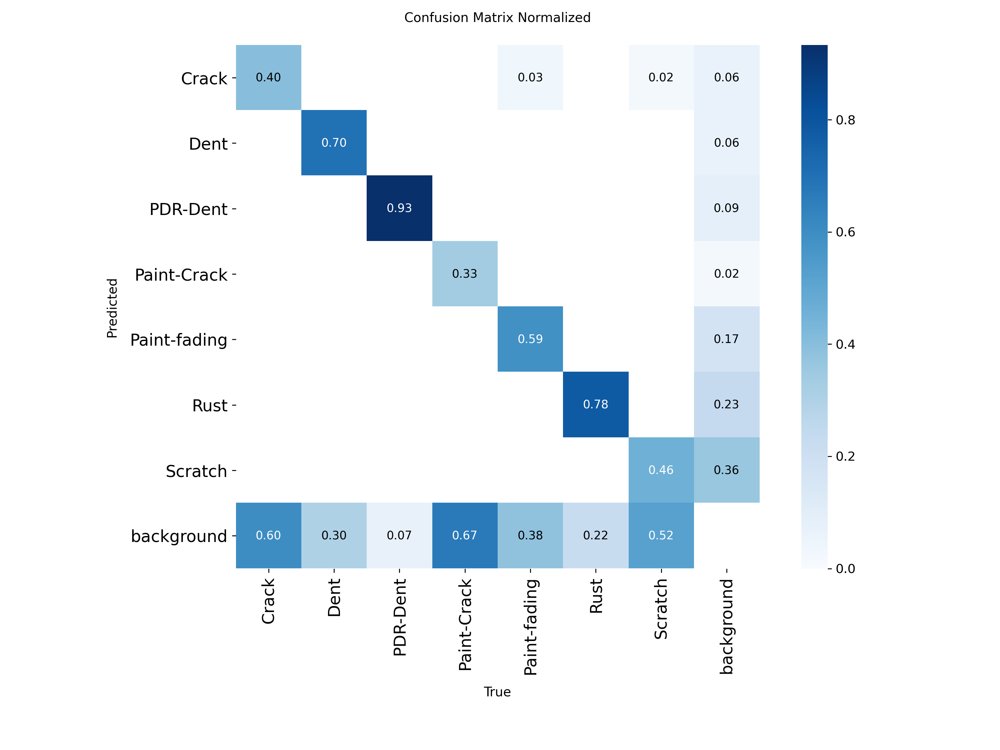

In [ ]:
# Display confusion matrix image
display(Image(filename='/content/runs/detect/train/confusion_matrix_normalized.png'))

# YOLOv8 Model Evaluation
The script evaluates the trained YOLOv8 model by loading the best model weights and displaying various evaluation curves, such as the F1 curve, precision-recall (PR) curve, precision curve, recall curve, and the normalized confusion matrix.

In [ ]:
# Evaluate the YOLOv8 model with specified parameters
!yolo val model='/content/runs/detect/train/weights/best.pt' data='/content/data.yaml' imgsz=640

Ultralytics 8.3.161 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,843,813 parameters, 0 gradients, 78.7 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1086.1±469.6 MB/s, size: 29.8 KB)
val: Scanning /content/valid/labels.cache... 69 images, 0 backgrounds, 0 corrupt: 100% 69/69 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 5/5 [00:03<00:00,  1.48it/s]
                   all         69        141      0.781      0.517      0.627      0.353
                 Crack          7         15      0.598      0.267      0.345      0.242
                  Dent         10         10          1       0.59      0.777       0.54
              PDR-Dent         13         15      0.907      0.867       0.93      0.407
           Paint-Crack          5          6      0.813      0.333      0.623      0.341
          Paint-fading         15         29       0.74      0.586      

In [ ]:
# Show training arguments
!cat /content/runs/detect/train/args.yaml

cat: /content/runs/detect/train/args.yaml: No such file or directory


Evaluation Curves

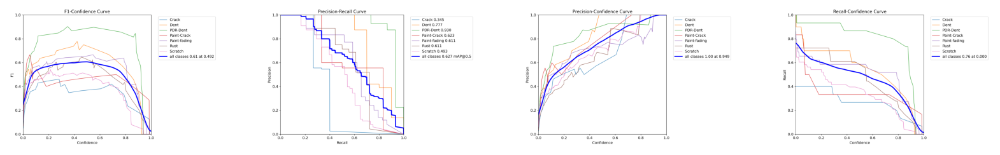

In [ ]:
# Sample paths to four evaluation images
img_paths = [
    '/content/runs/detect/val/F1_curve.png',
    '/content/runs/detect/val/PR_curve.png',
    '/content/runs/detect/val/P_curve.png',
    '/content/runs/detect/val/R_curve.png'
]

# Create a subplot with 1 row and 4 columns
fig, axs = plt.subplots(1, 4, figsize=(20, 5))  # Adjust the figure size as needed

# Display each image in the subplot
for ax, img_path in zip(axs, img_paths):
    img = PILImage.open(img_path)
    ax.imshow(img)
    ax.axis('off')  # Turn off the axis for better readability
plt.show()

confusion matrix

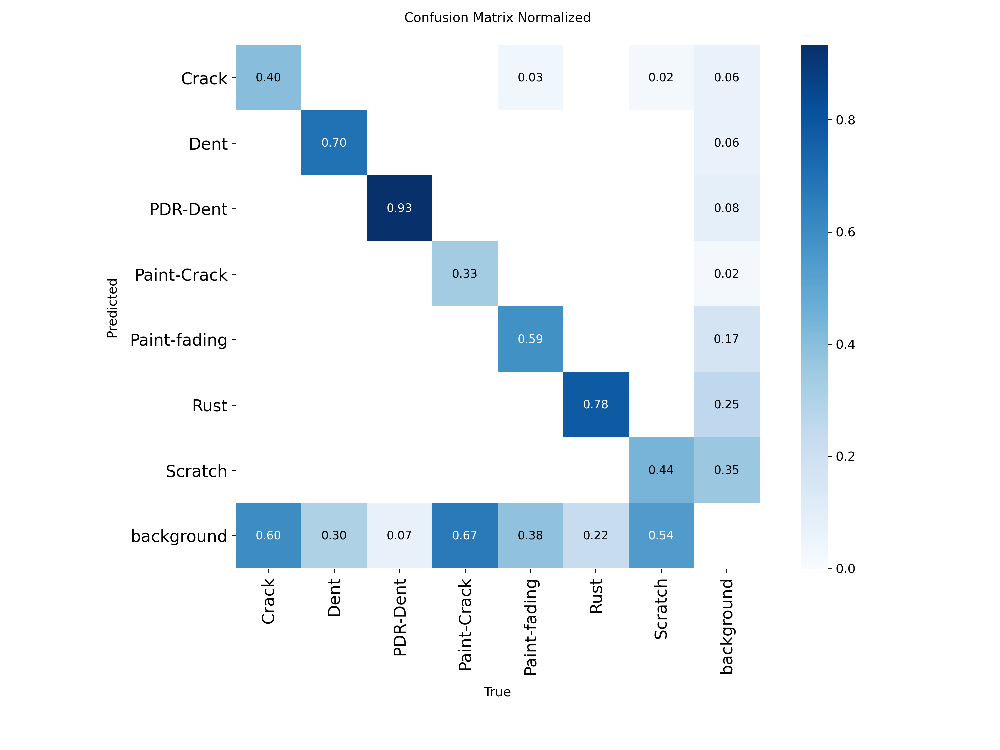

In [ ]:
# Display the confusion matrix image
display(Image(filename='/content/runs/detect/val/confusion_matrix_normalized.png'))

# Loading and Prediction with YOLOv8 Model
The script loads the trained YOLOv8 model and performs predictions on the test dataset. Bounding boxes and labels for the detected objects are drawn on the images, which are then displayed.


0: 640x640 1 Crack, 1 Dent, 1 Scratch, 36.2ms
Speed: 4.7ms preprocess, 36.2ms inference, 144.9ms postprocess per image at shape (1, 3, 640, 640)


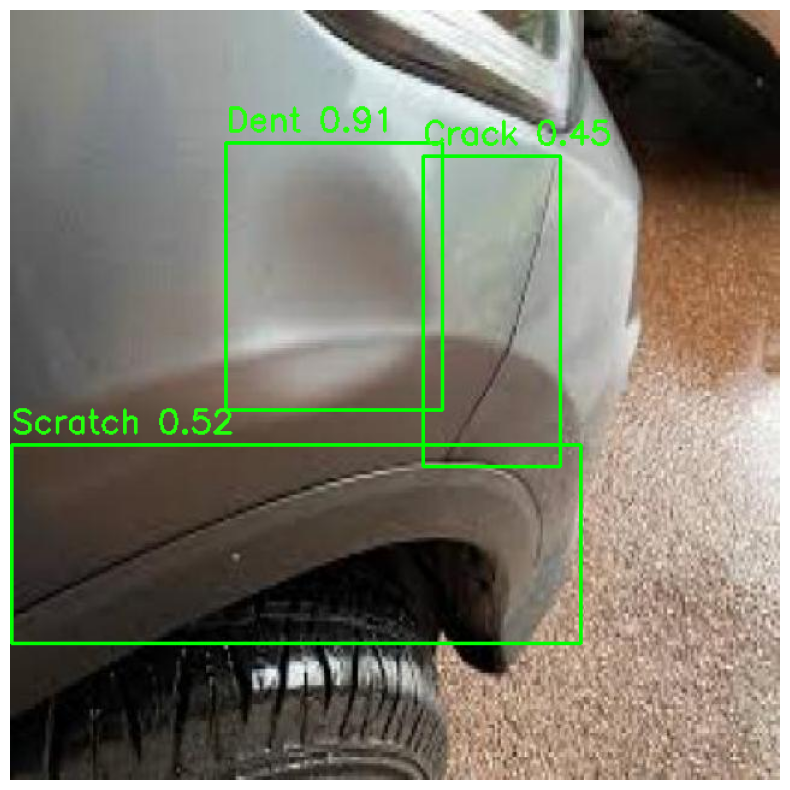


0: 640x640 1 Paint-fading, 5 Rusts, 36.3ms
Speed: 2.5ms preprocess, 36.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


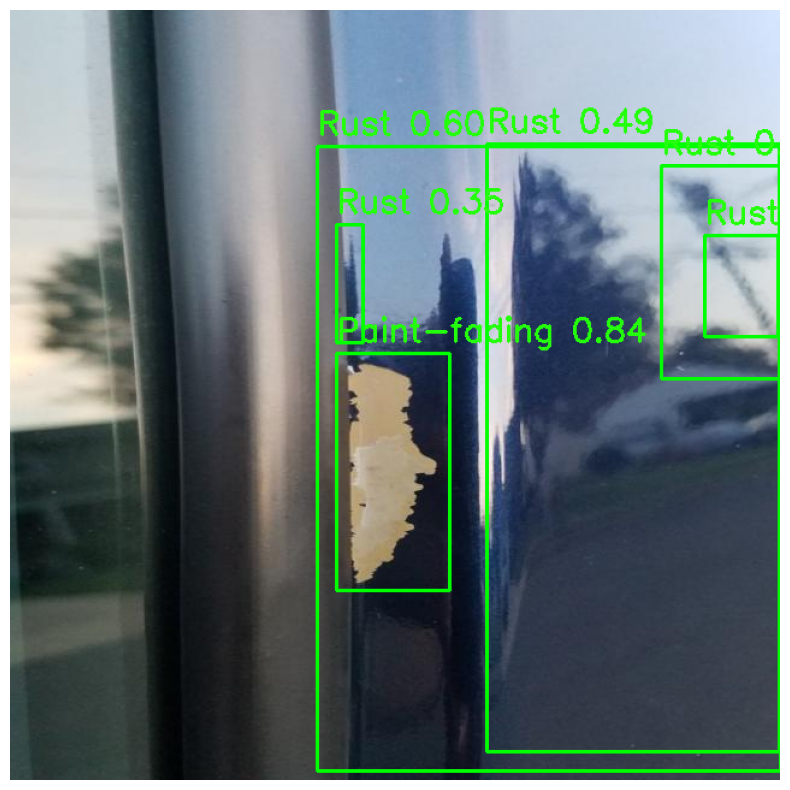


0: 640x640 (no detections), 36.4ms
Speed: 2.7ms preprocess, 36.4ms inference, 1.0ms postprocess per image at shape (1, 3, 640, 640)


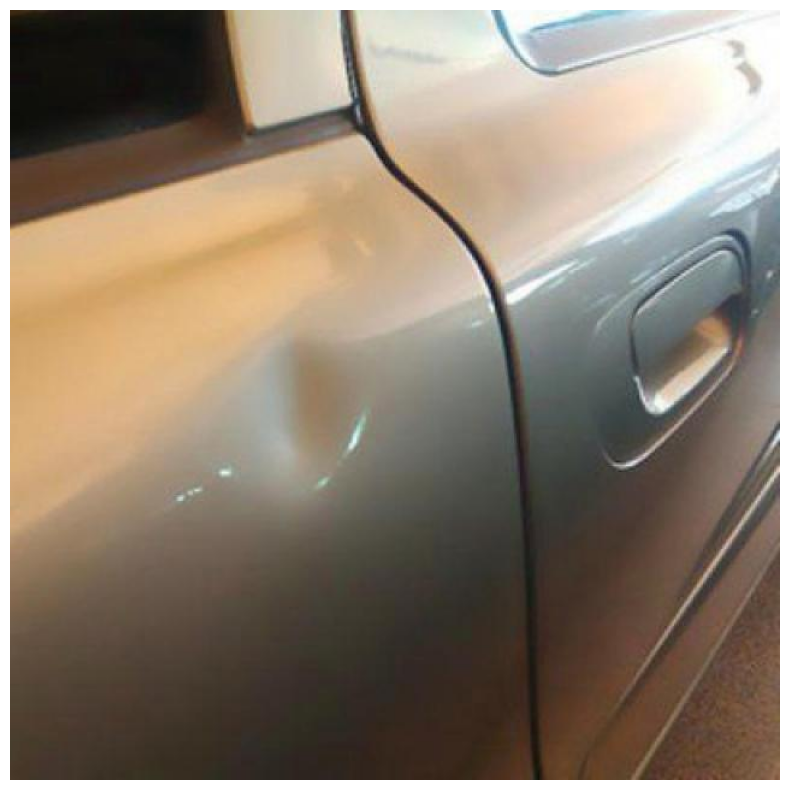


0: 640x640 (no detections), 36.4ms
Speed: 2.7ms preprocess, 36.4ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


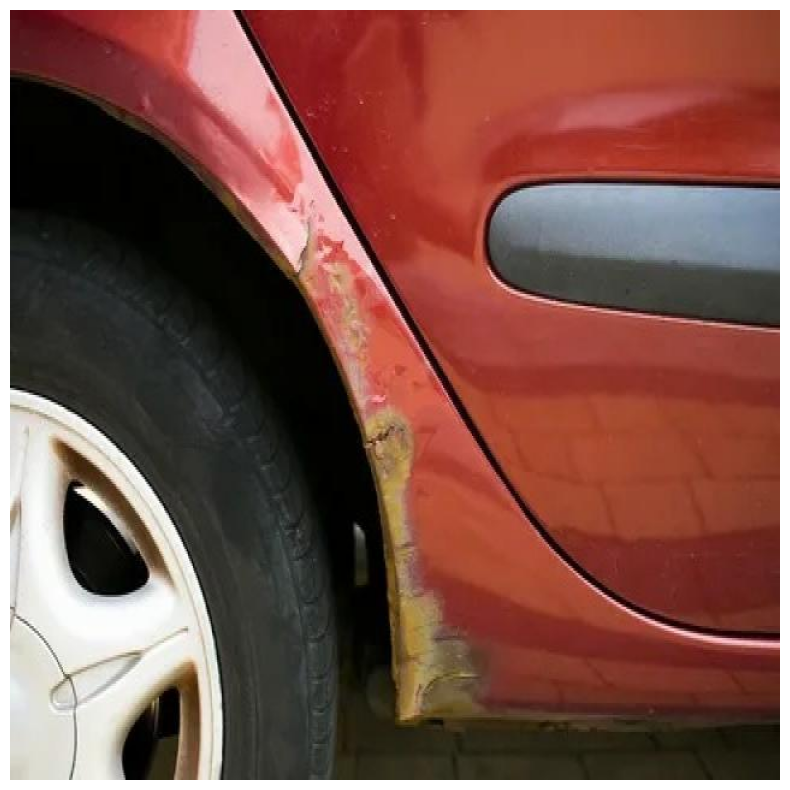


0: 640x640 1 Crack, 1 Rust, 36.3ms
Speed: 2.7ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


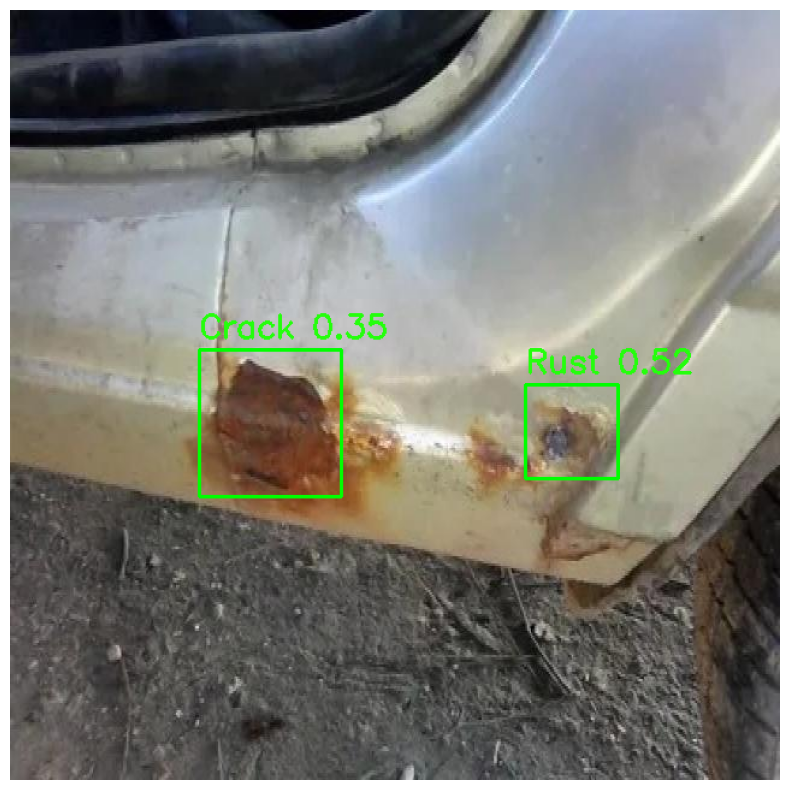


0: 640x640 1 Crack, 1 Scratch, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


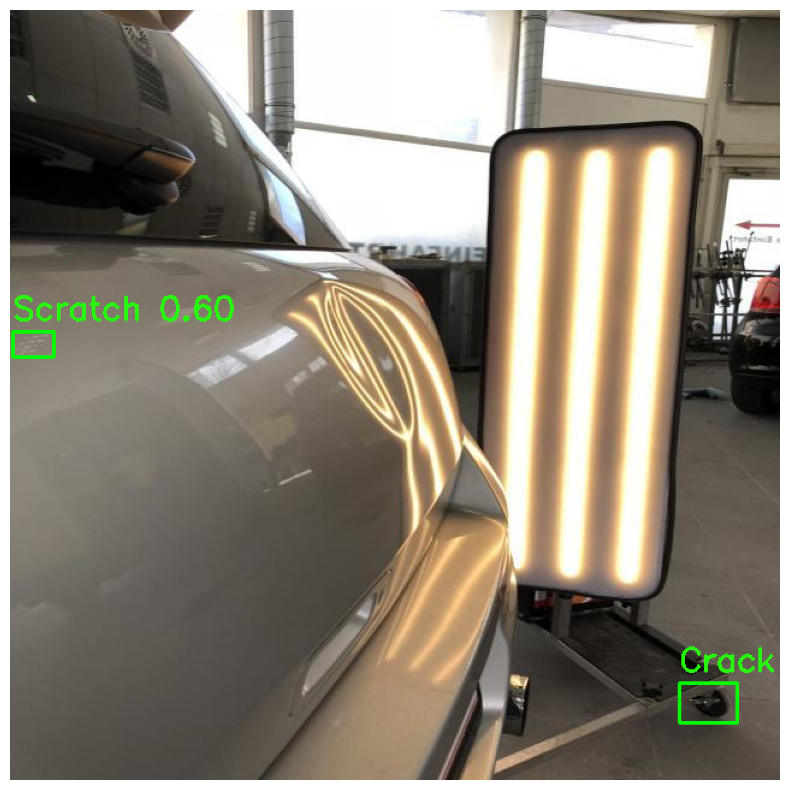


0: 640x640 1 Crack, 36.4ms
Speed: 3.9ms preprocess, 36.4ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


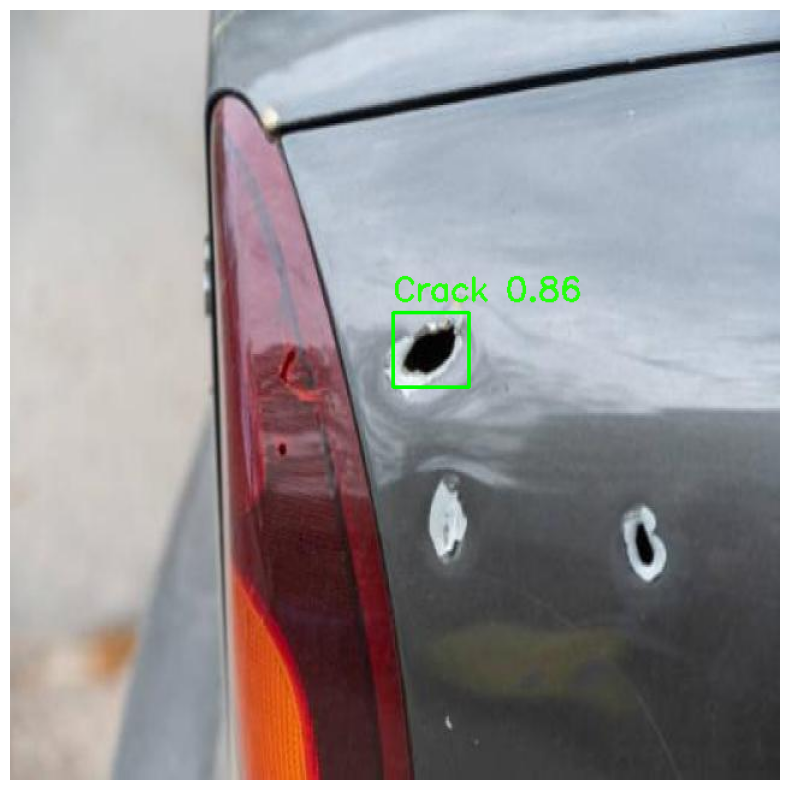


0: 640x640 1 PDR-Dent, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


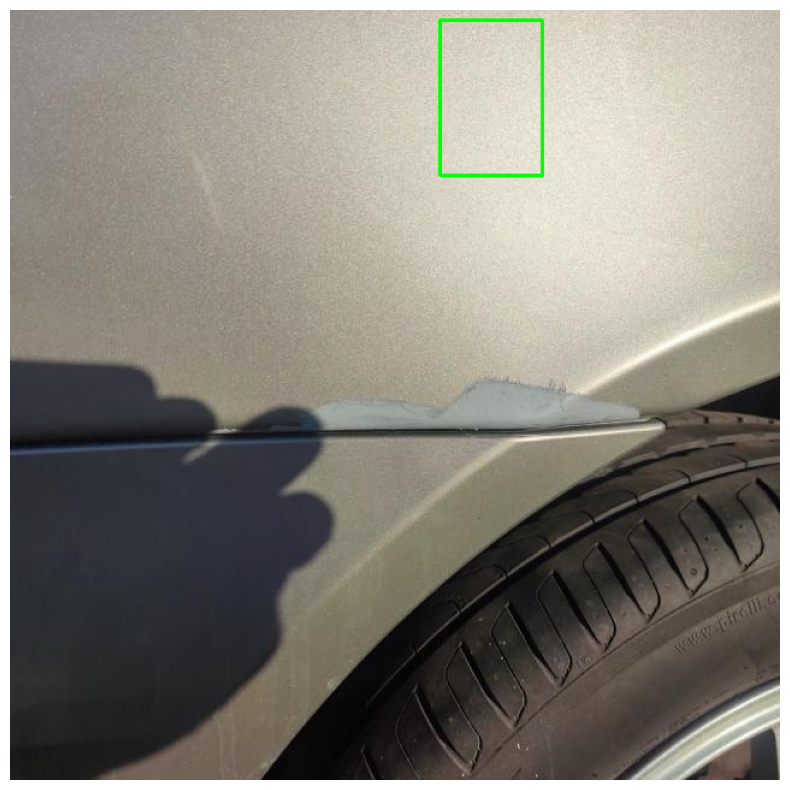


0: 640x640 1 Crack, 1 Paint-fading, 1 Scratch, 36.3ms
Speed: 3.8ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


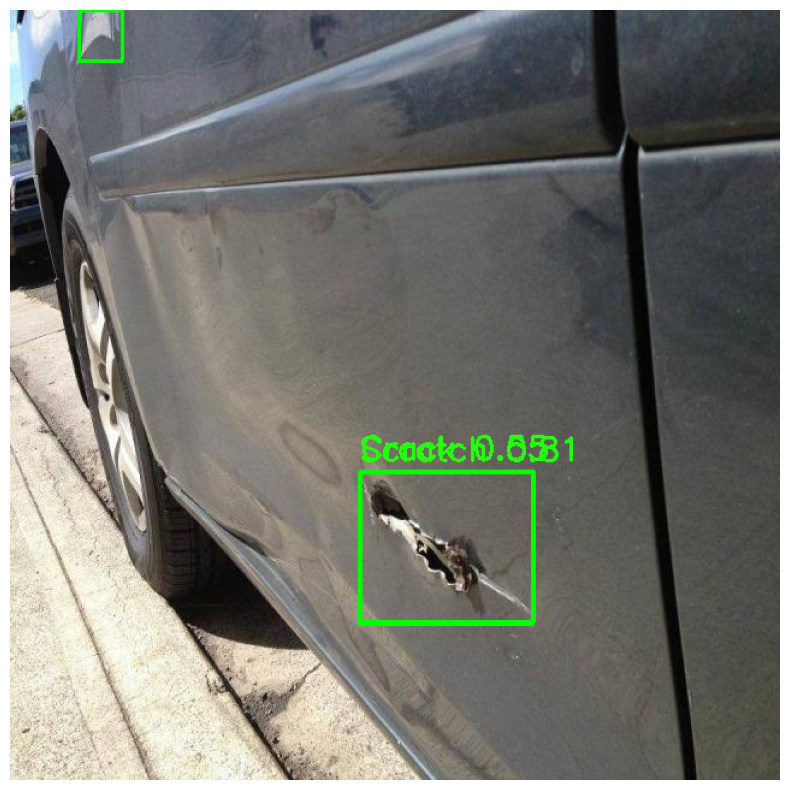


0: 640x640 4 PDR-Dents, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 640)


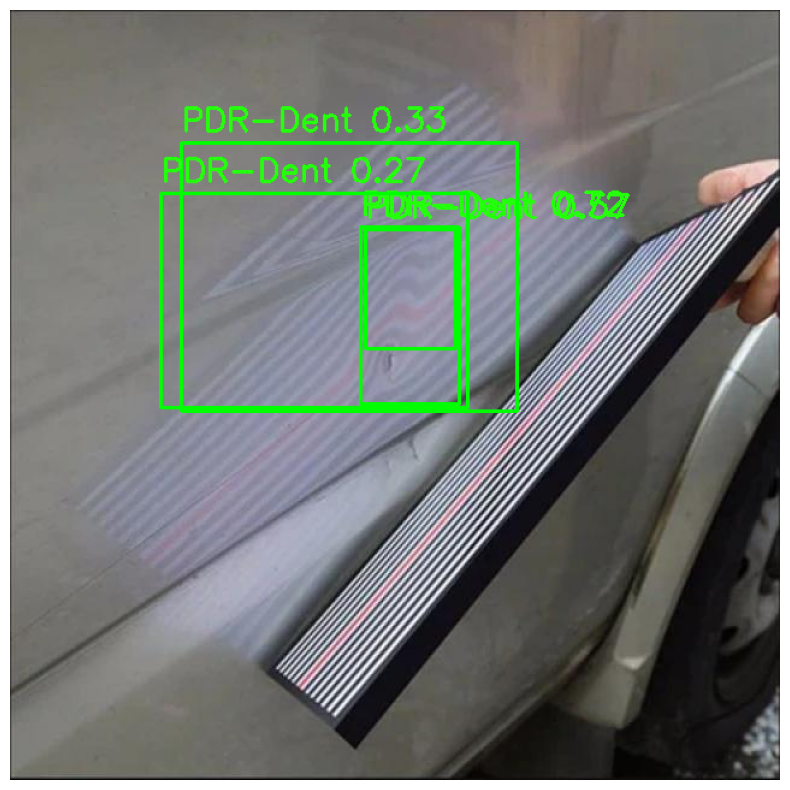


0: 640x640 1 Scratch, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 7.7ms postprocess per image at shape (1, 3, 640, 640)


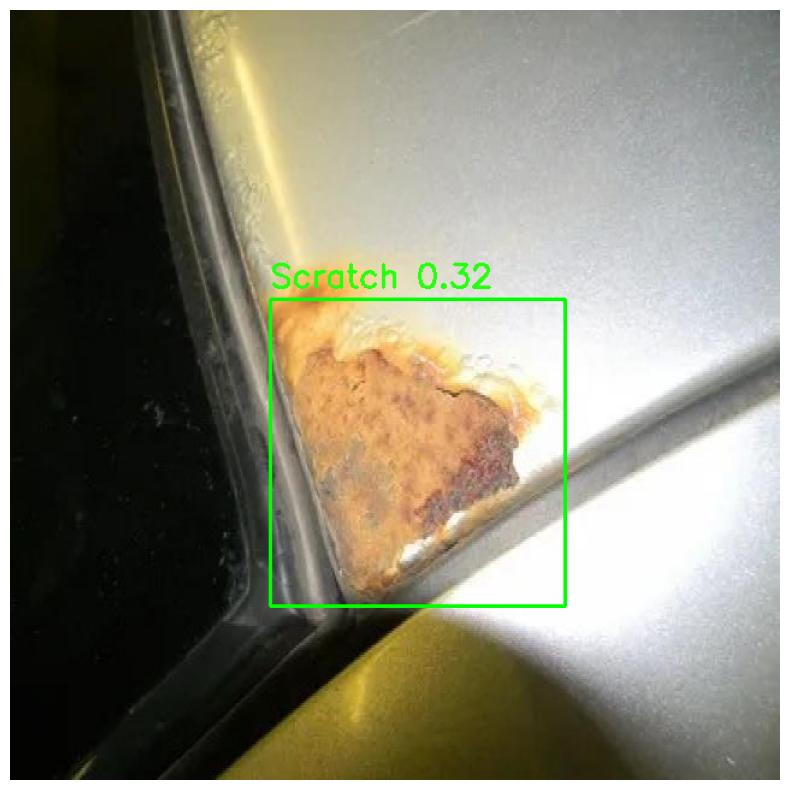


0: 640x640 1 Paint-Crack, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


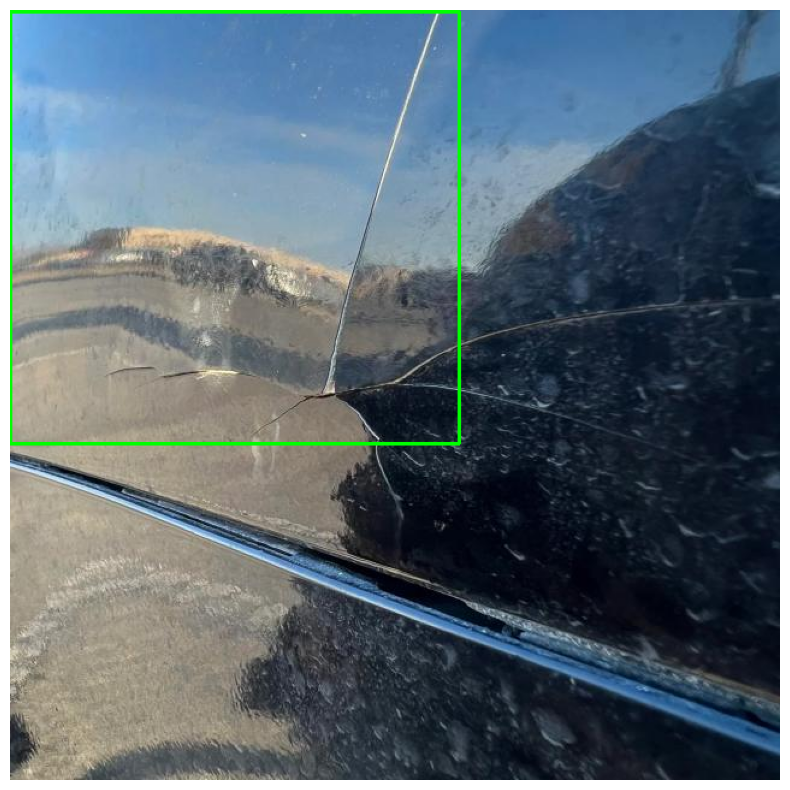


0: 640x640 2 Cracks, 1 Paint-Crack, 1 Scratch, 36.3ms
Speed: 2.7ms preprocess, 36.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


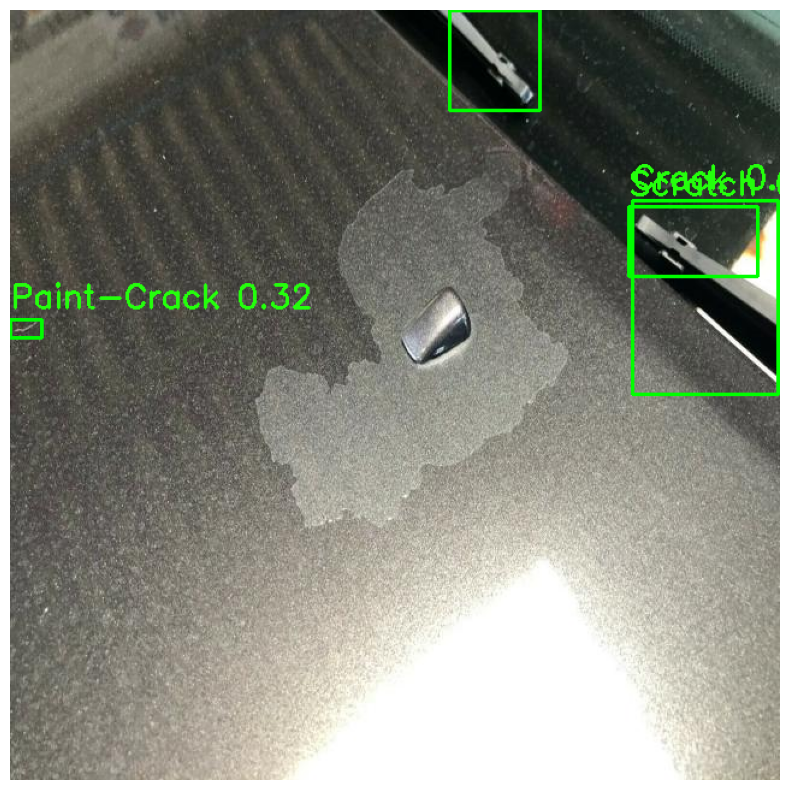


0: 640x640 2 Paint-Cracks, 1 Scratch, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


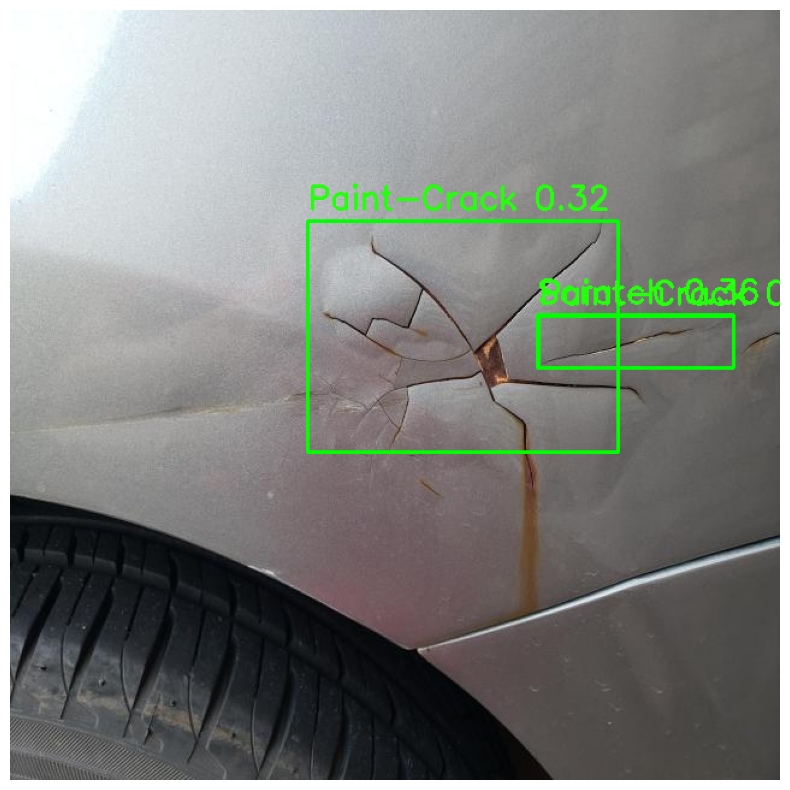


0: 640x640 4 Paint-Cracks, 36.3ms
Speed: 2.7ms preprocess, 36.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


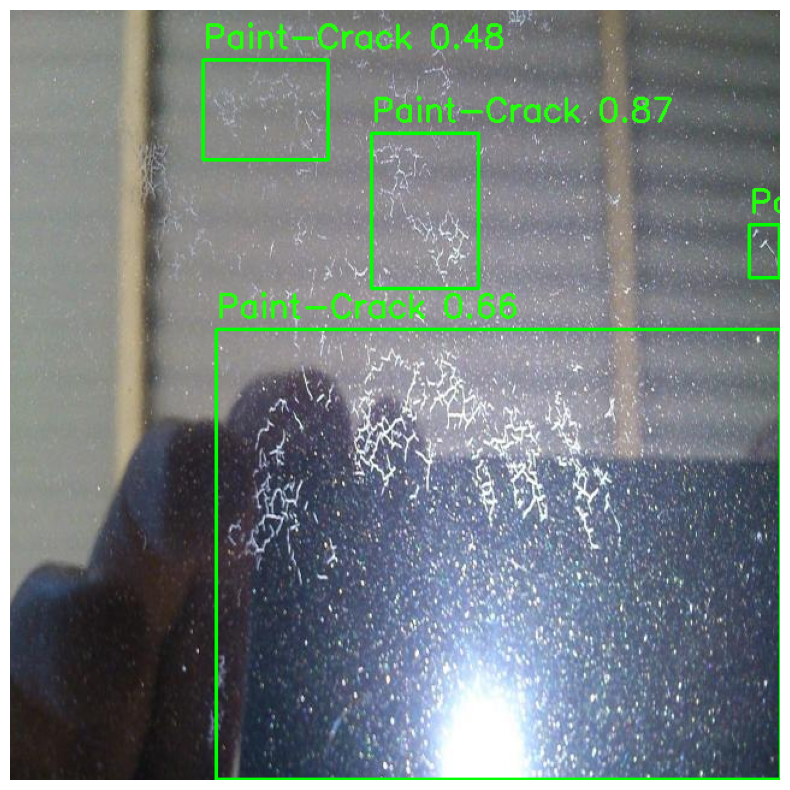


0: 640x640 1 Paint-Crack, 1 Scratch, 36.3ms
Speed: 3.2ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


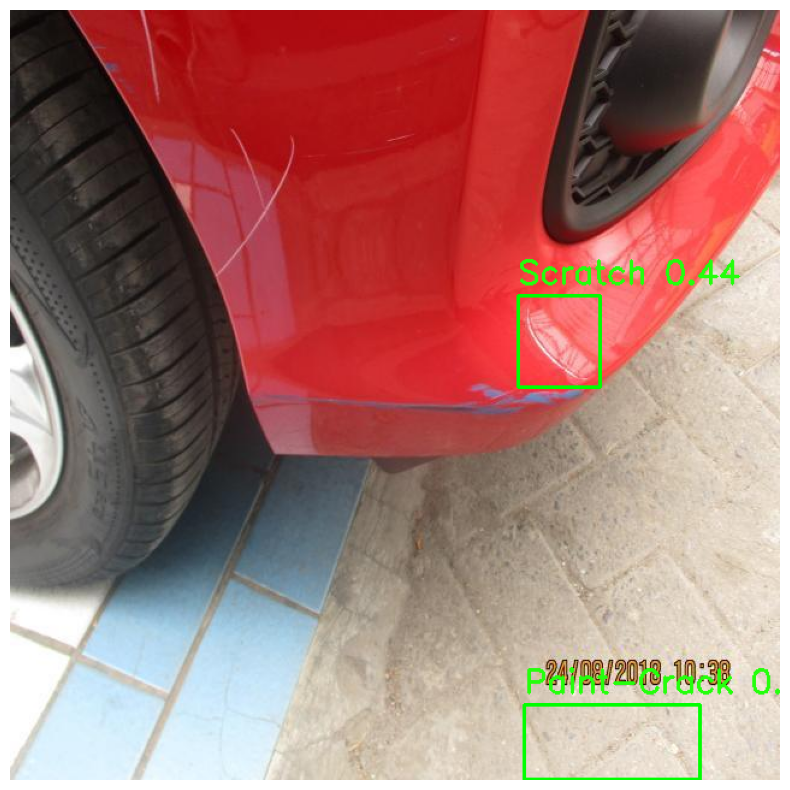


0: 640x640 3 Cracks, 1 Paint-Crack, 36.4ms
Speed: 2.9ms preprocess, 36.4ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


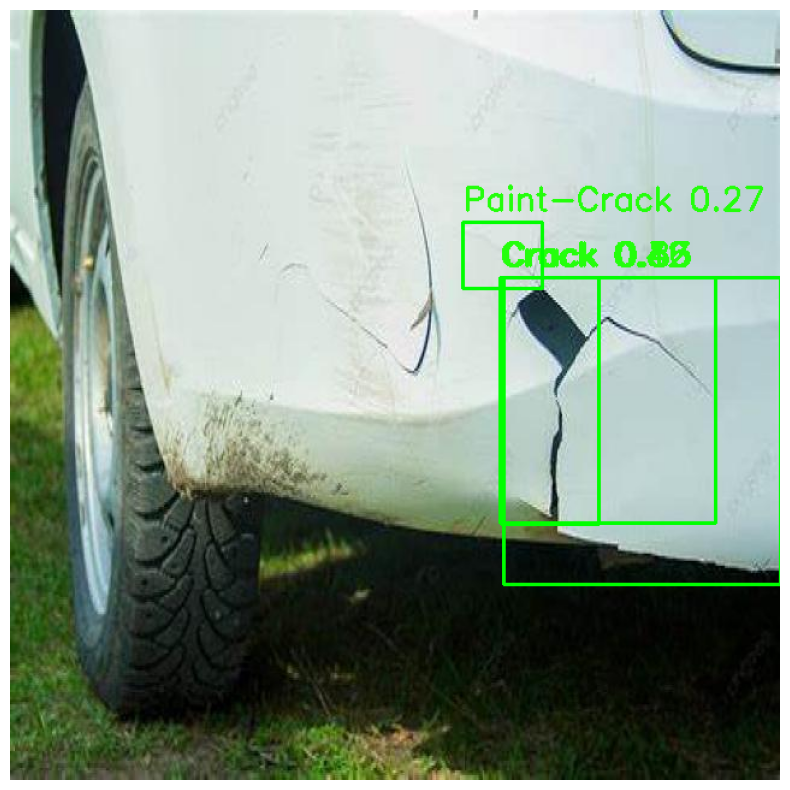


0: 640x640 1 Scratch, 38.7ms
Speed: 2.9ms preprocess, 38.7ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


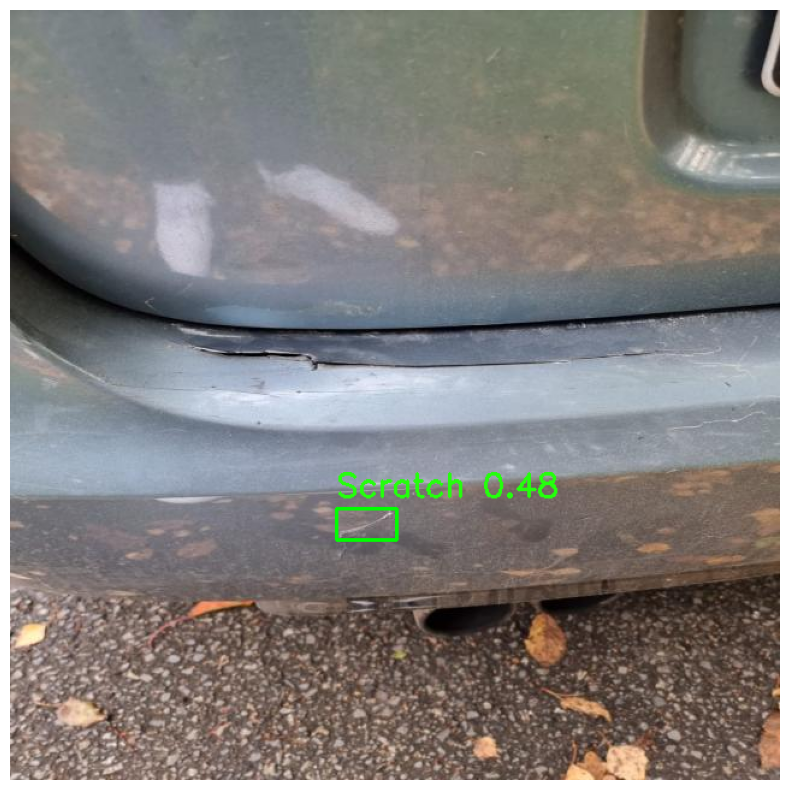


0: 640x640 3 Scratchs, 36.6ms
Speed: 2.6ms preprocess, 36.6ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


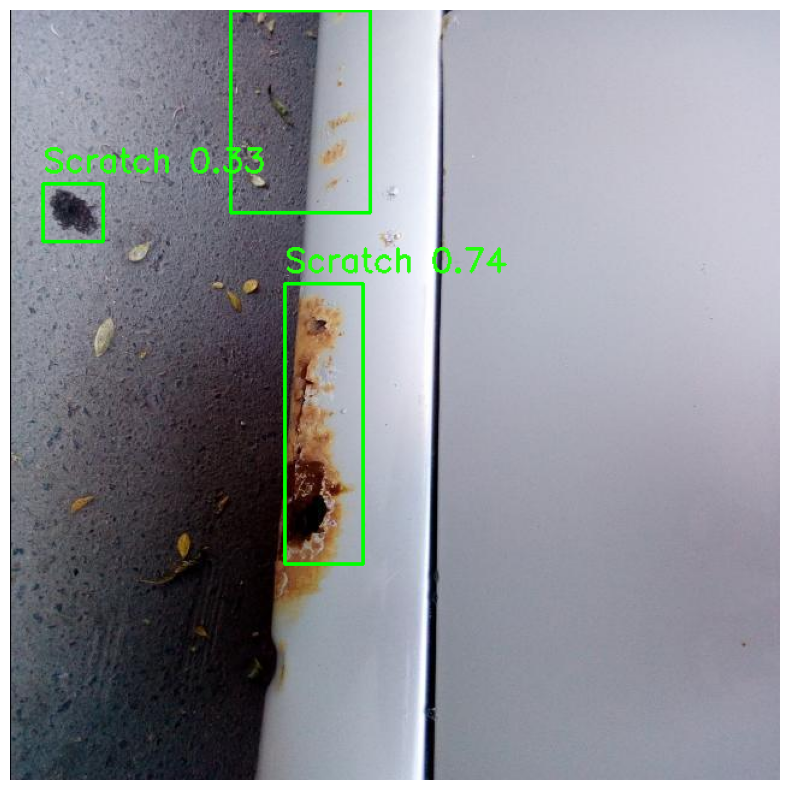


0: 640x640 3 PDR-Dents, 36.3ms
Speed: 2.9ms preprocess, 36.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


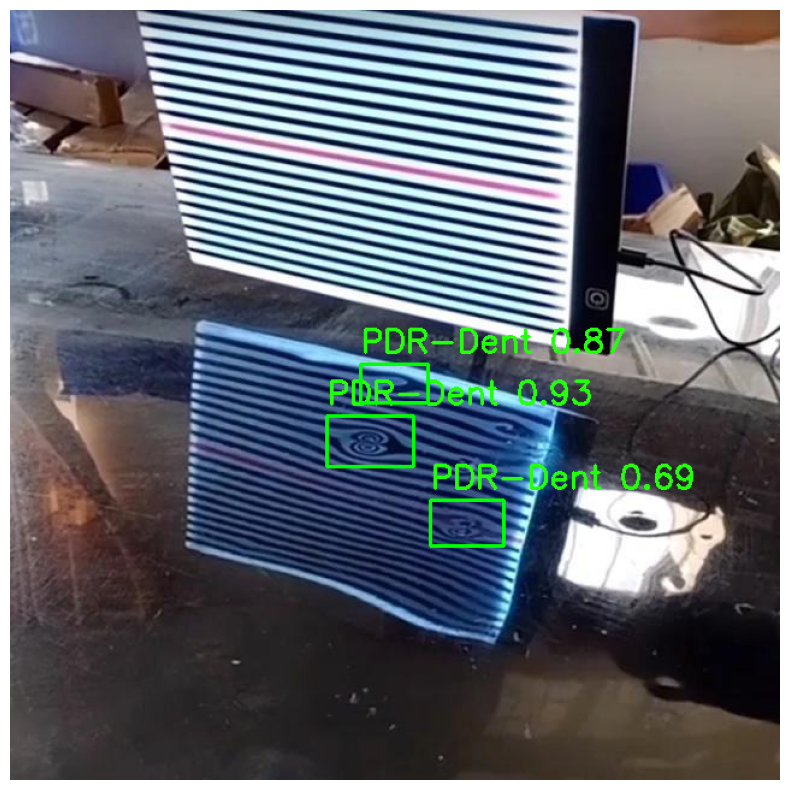


0: 640x640 1 Rust, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


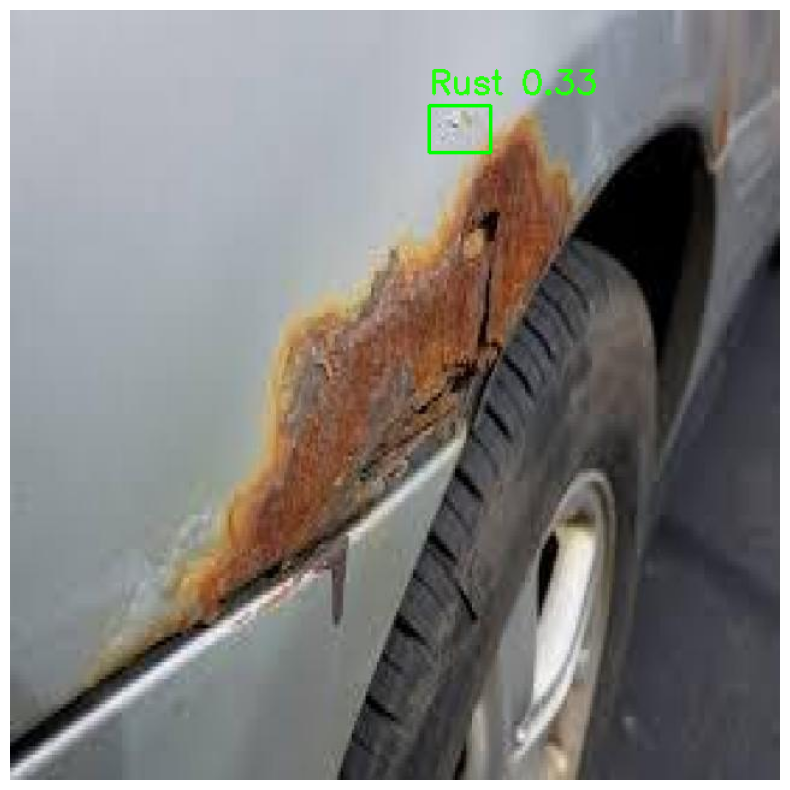


0: 640x640 1 Paint-fading, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


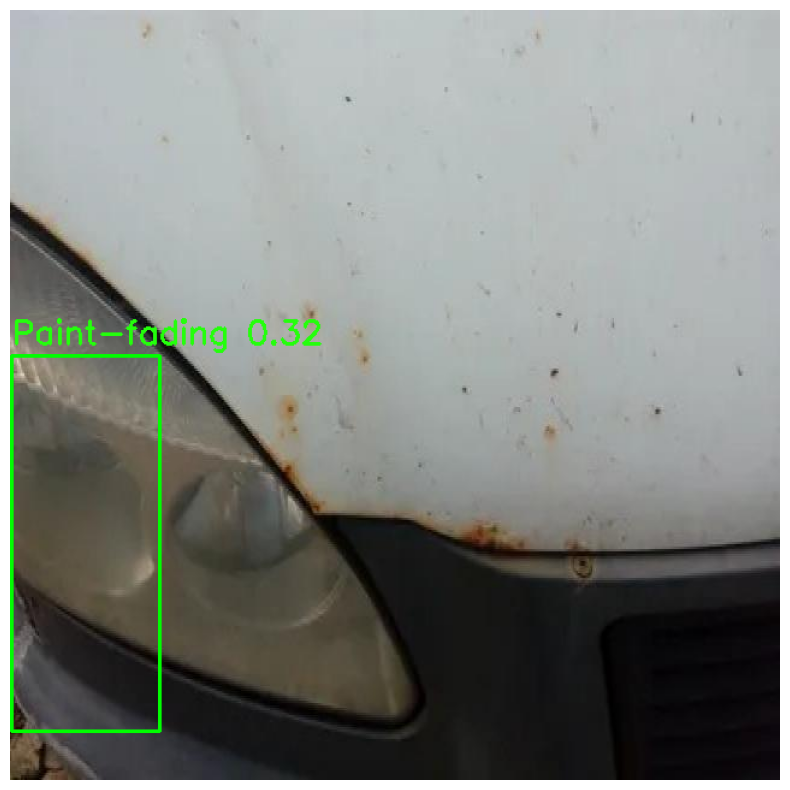


0: 640x640 1 Crack, 1 Scratch, 36.3ms
Speed: 2.9ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


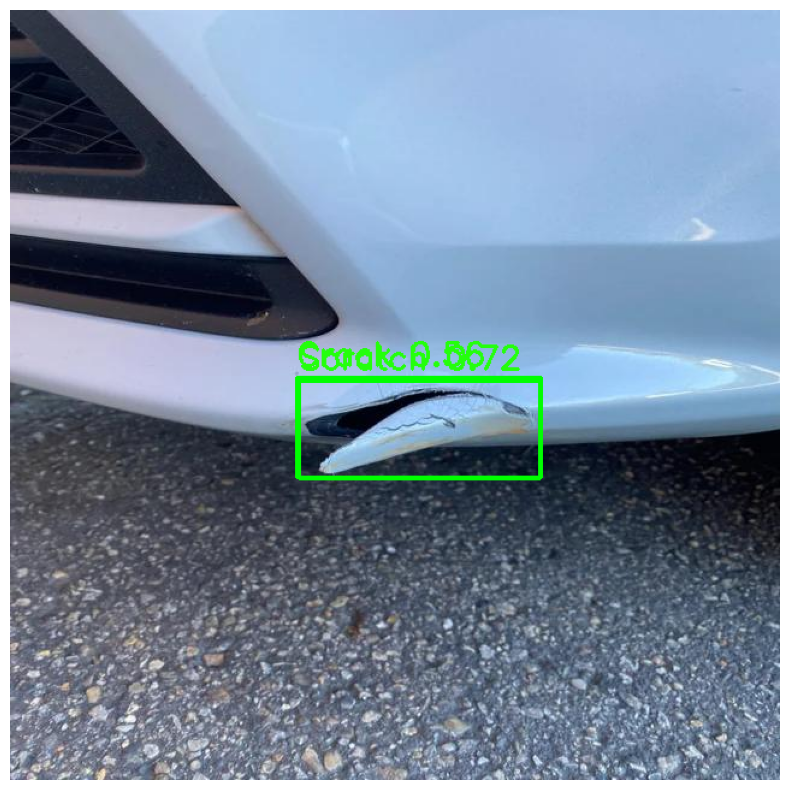


0: 640x640 6 Scratchs, 36.5ms
Speed: 2.6ms preprocess, 36.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


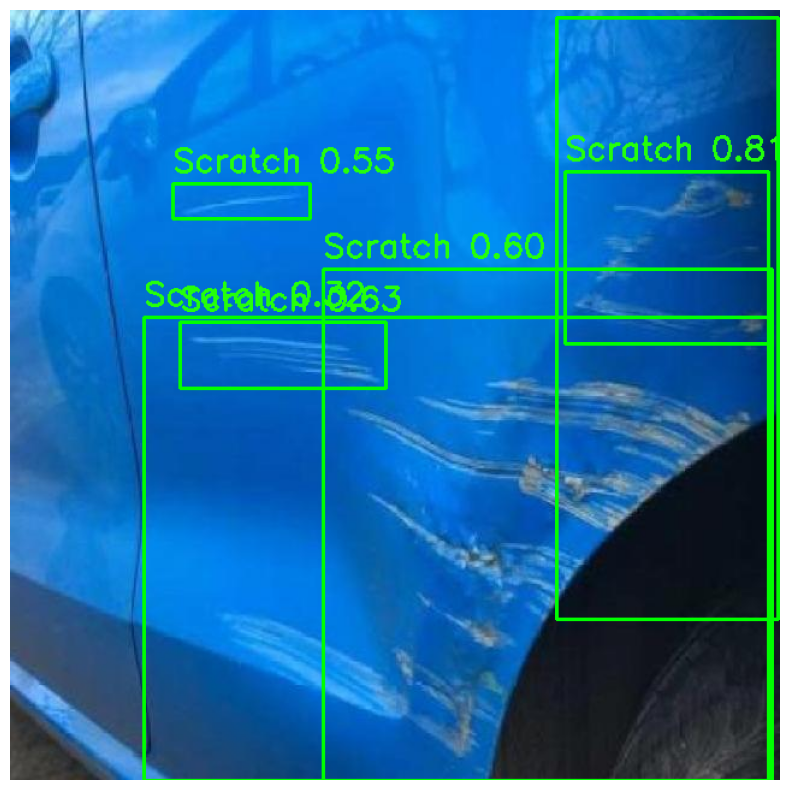


0: 640x640 (no detections), 36.3ms
Speed: 2.7ms preprocess, 36.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


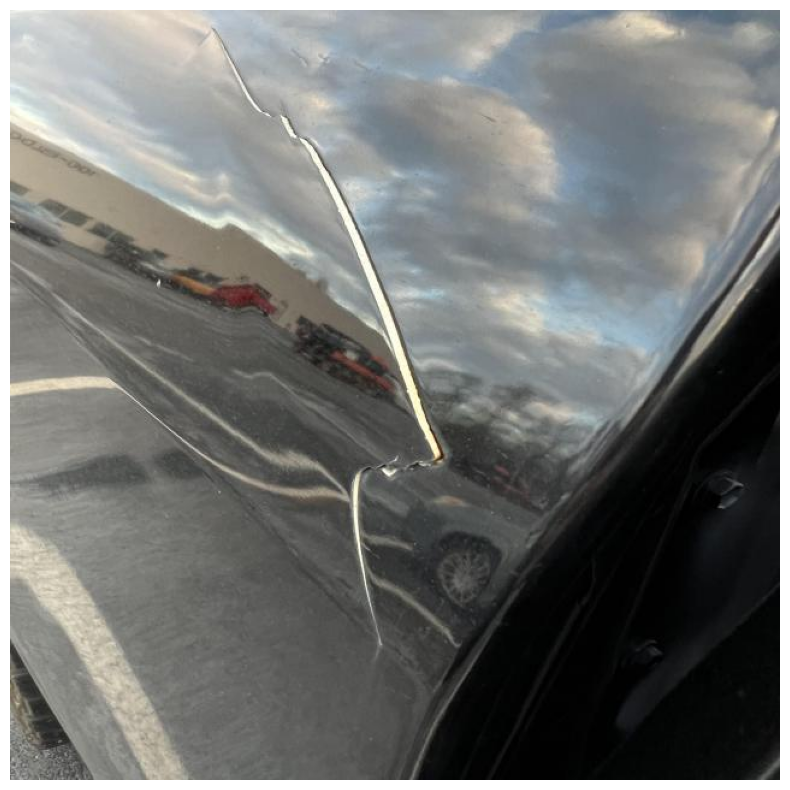


0: 640x640 1 Crack, 1 Rust, 36.5ms
Speed: 2.7ms preprocess, 36.5ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


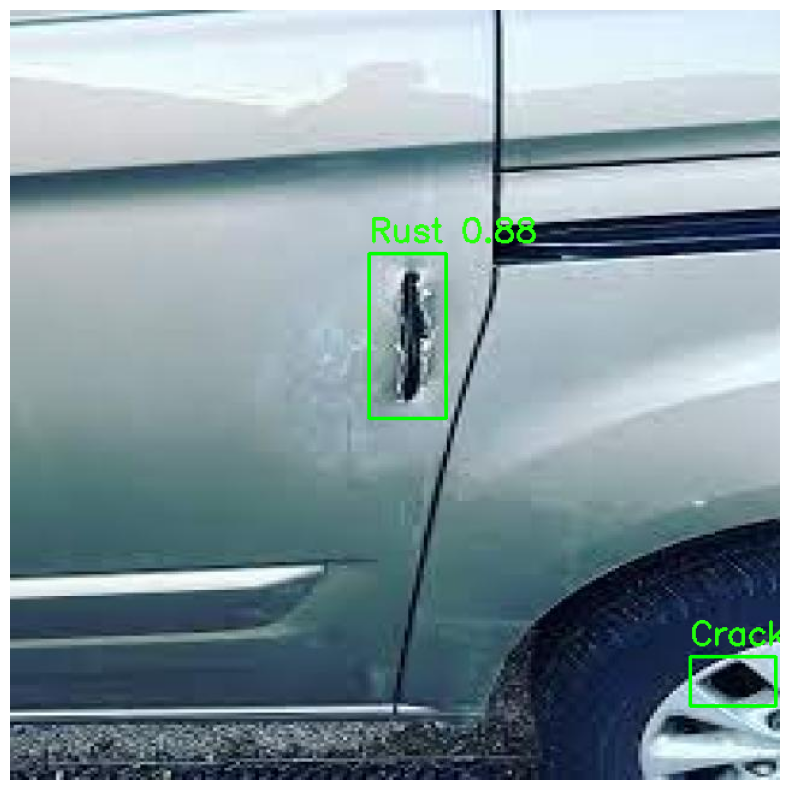


0: 640x640 1 Scratch, 39.9ms
Speed: 2.8ms preprocess, 39.9ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 640)


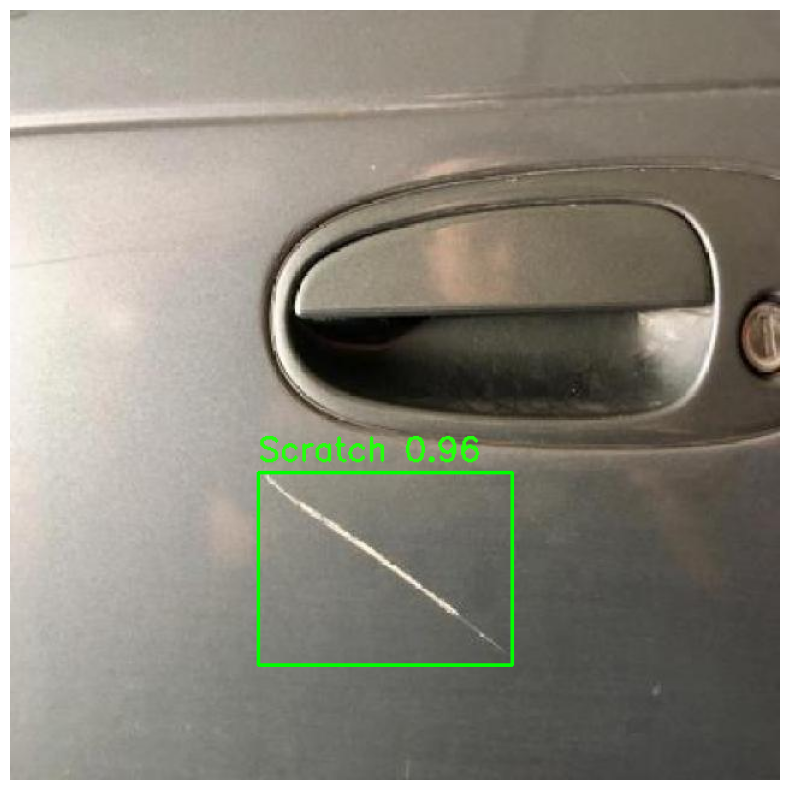


0: 640x640 2 Dents, 38.3ms
Speed: 2.7ms preprocess, 38.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


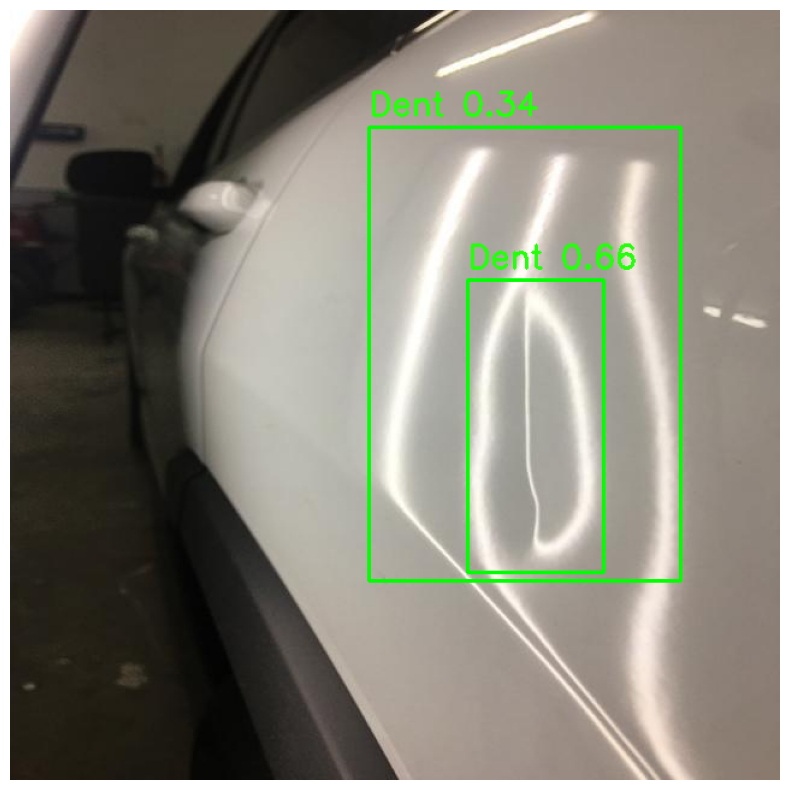


0: 640x640 1 Paint-fading, 36.4ms
Speed: 3.3ms preprocess, 36.4ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


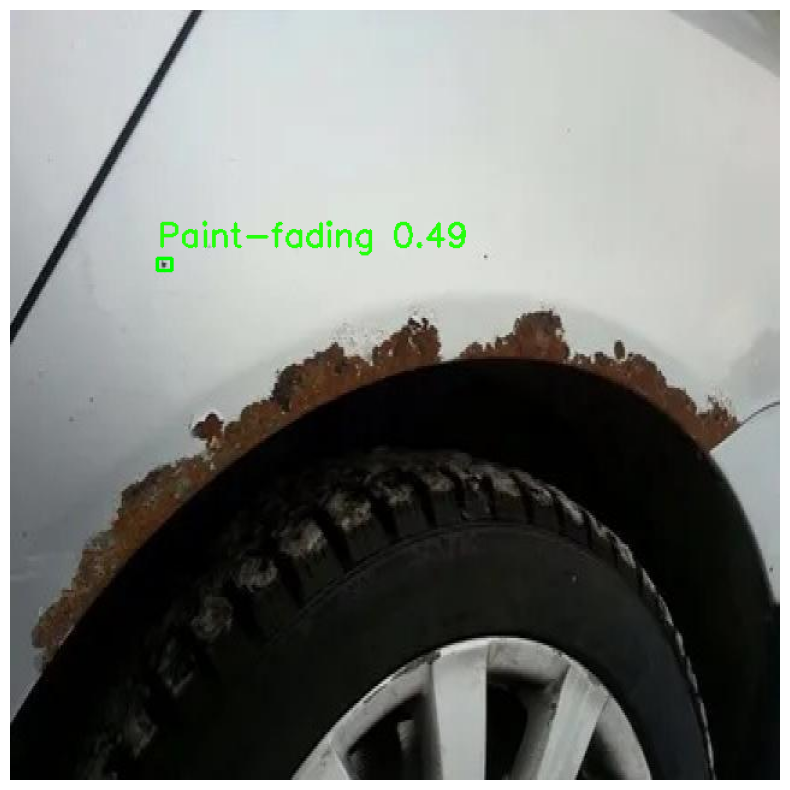


0: 640x640 2 Paint-fadings, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 3.1ms postprocess per image at shape (1, 3, 640, 640)


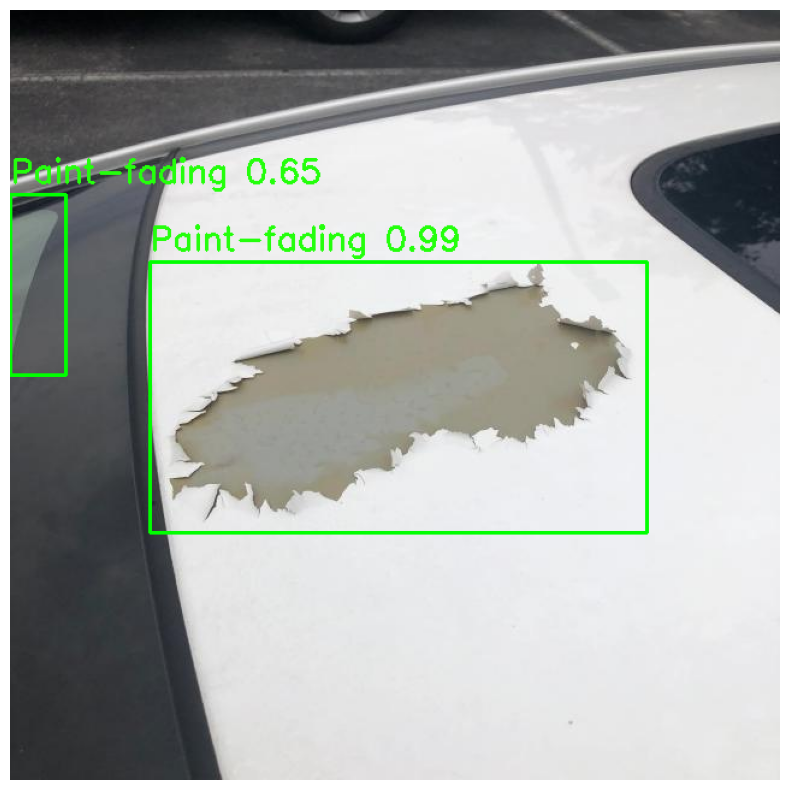


0: 640x640 1 Paint-Crack, 36.3ms
Speed: 2.7ms preprocess, 36.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


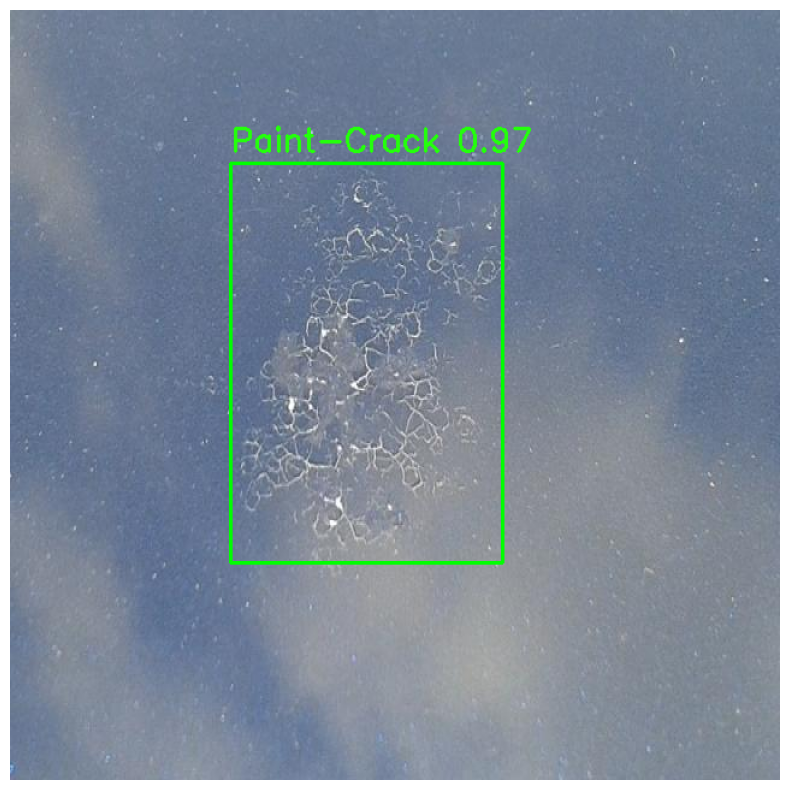


0: 640x640 4 Rusts, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


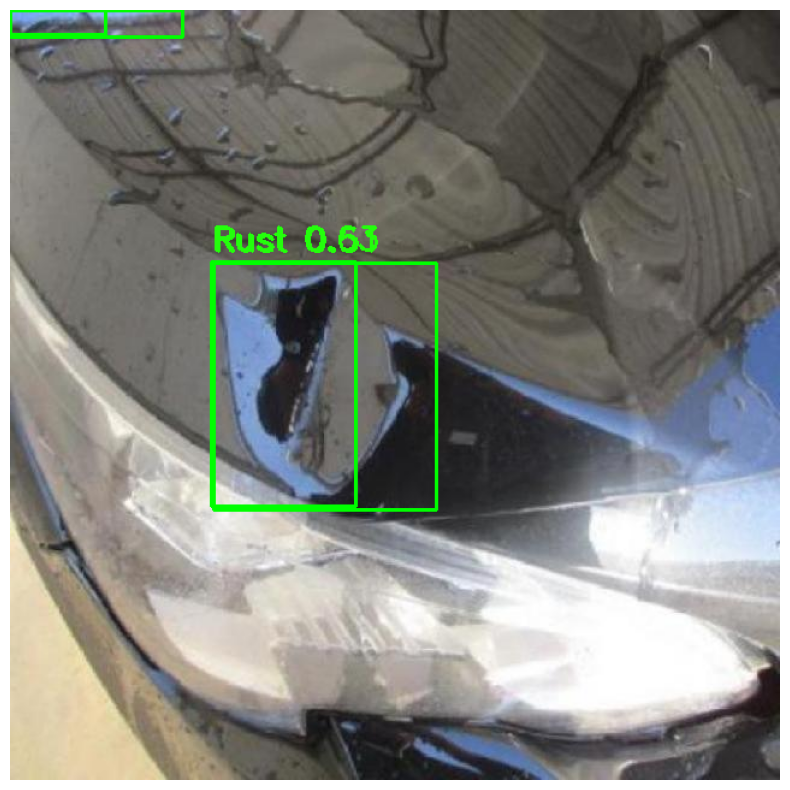


0: 640x640 1 PDR-Dent, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


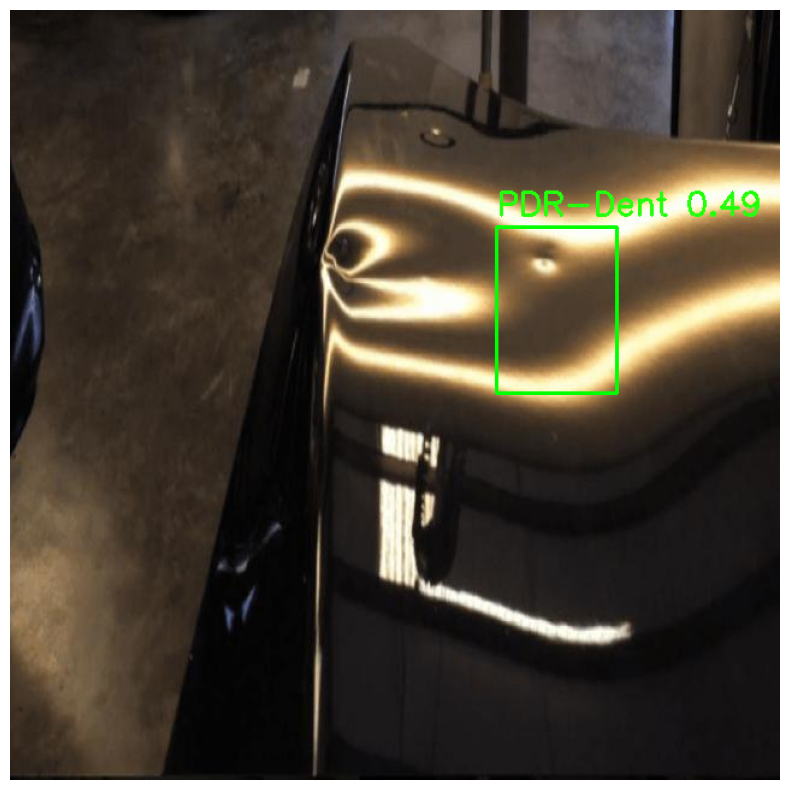


0: 640x640 1 Rust, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


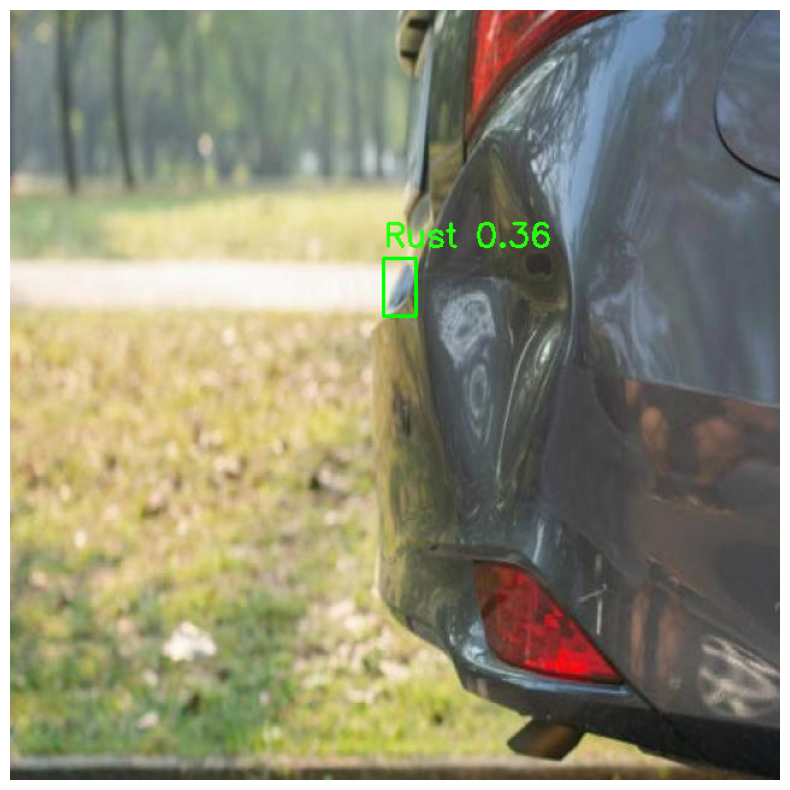


0: 640x640 2 Cracks, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


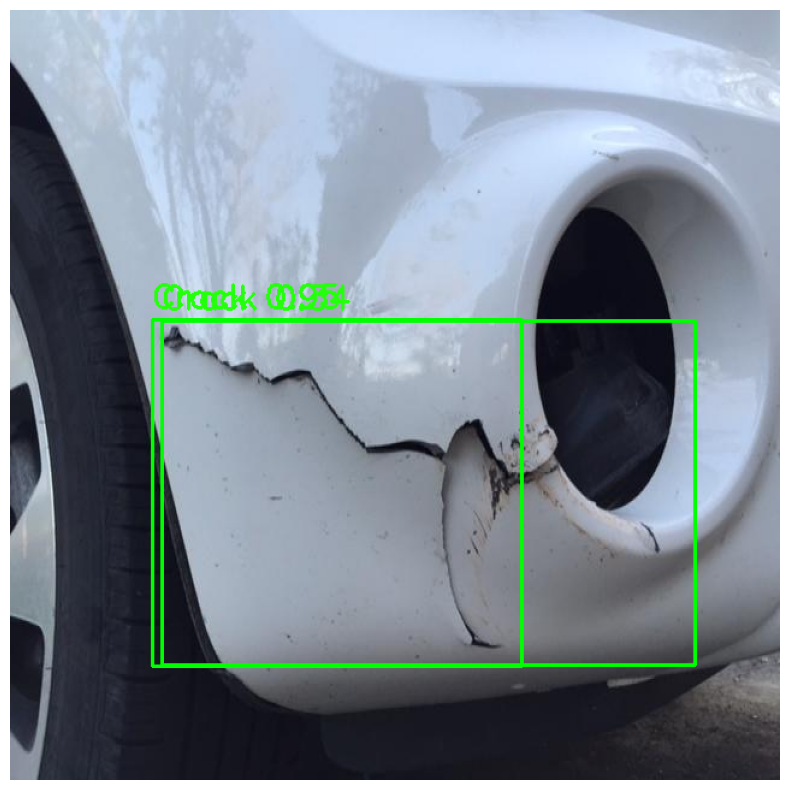


0: 640x640 1 Crack, 1 Paint-Crack, 1 Rust, 1 Scratch, 39.4ms
Speed: 2.8ms preprocess, 39.4ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


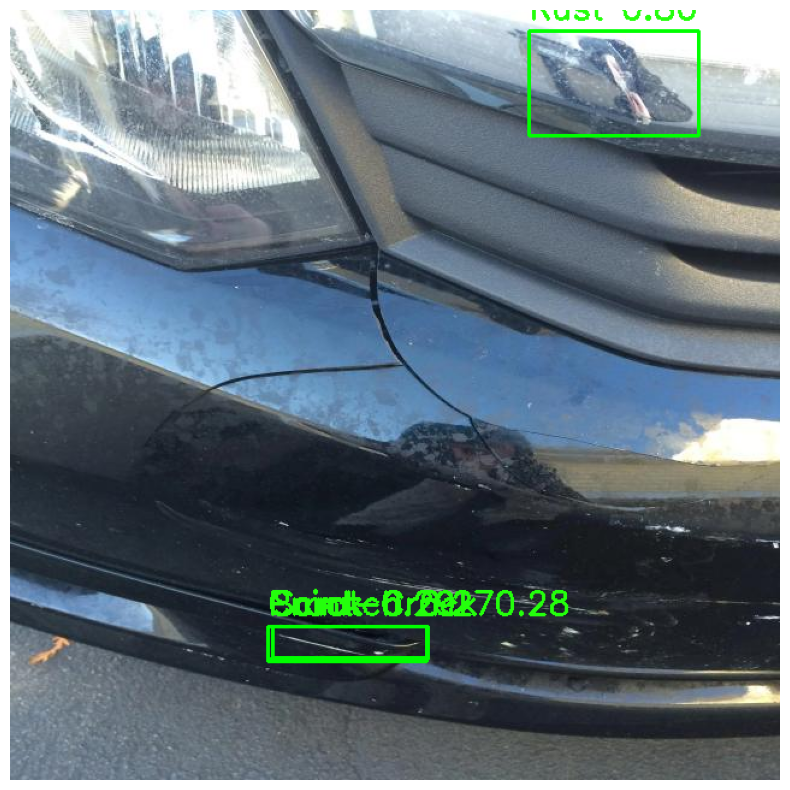


0: 640x640 2 PDR-Dents, 1 Scratch, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


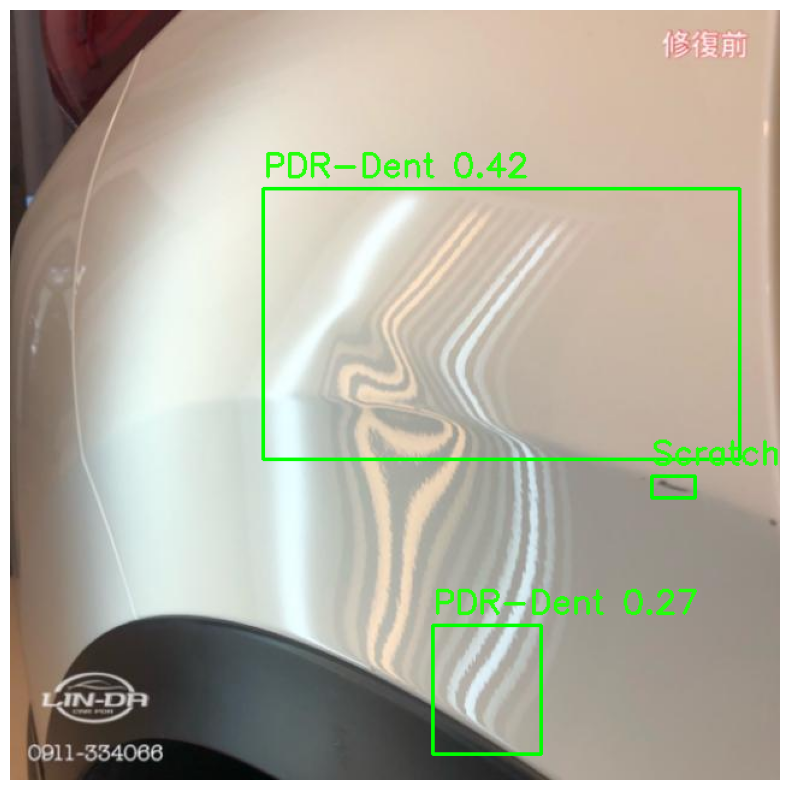


0: 640x640 1 Crack, 1 Scratch, 36.3ms
Speed: 2.8ms preprocess, 36.3ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


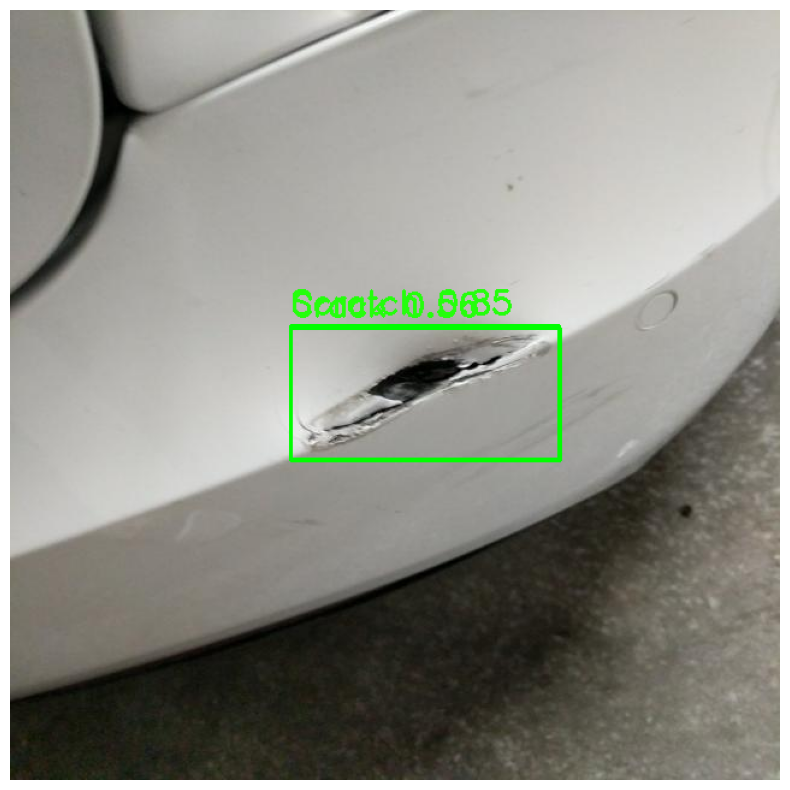


0: 640x640 2 Paint-fadings, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


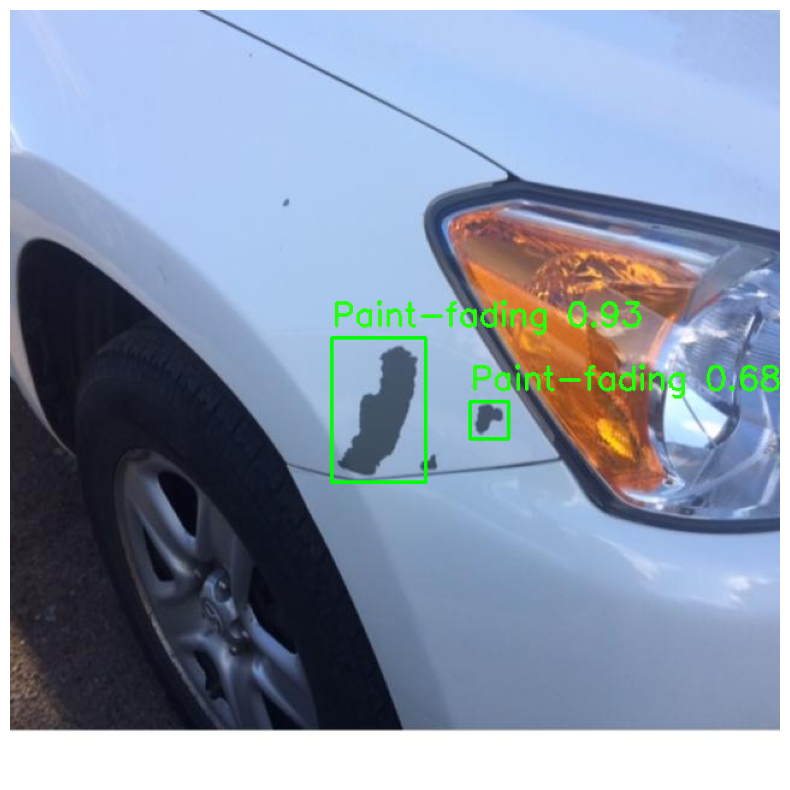


0: 640x640 2 Cracks, 40.5ms
Speed: 2.6ms preprocess, 40.5ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)


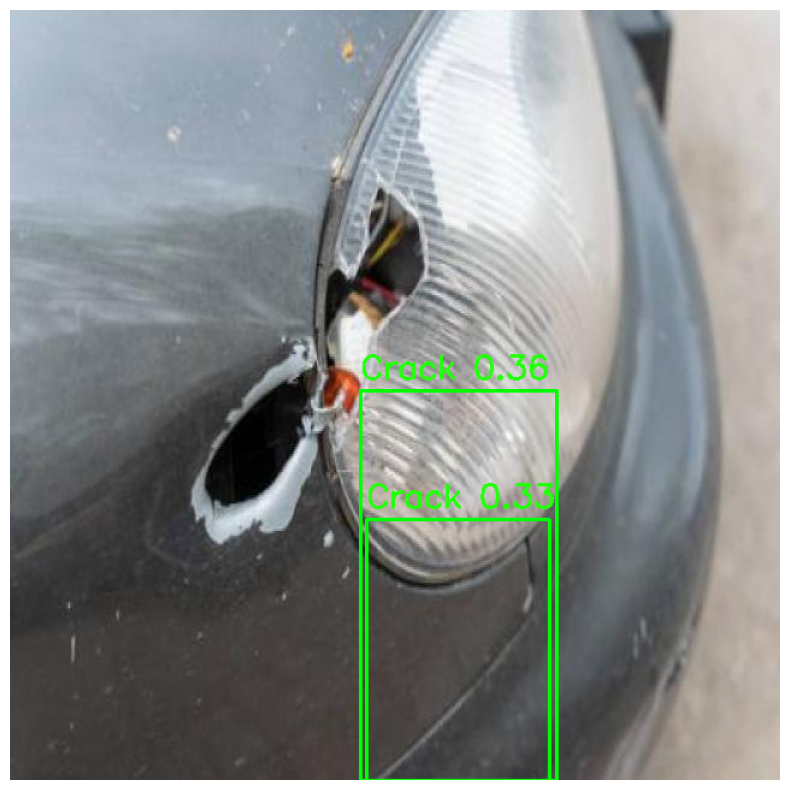


0: 640x640 1 Dent, 36.4ms
Speed: 2.7ms preprocess, 36.4ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


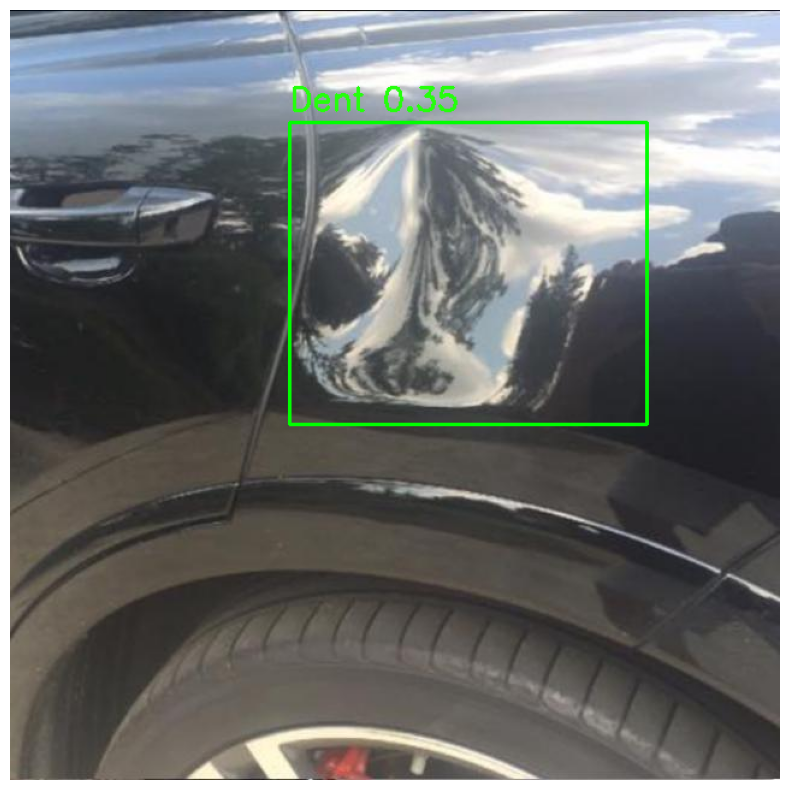


0: 640x640 1 Dent, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)


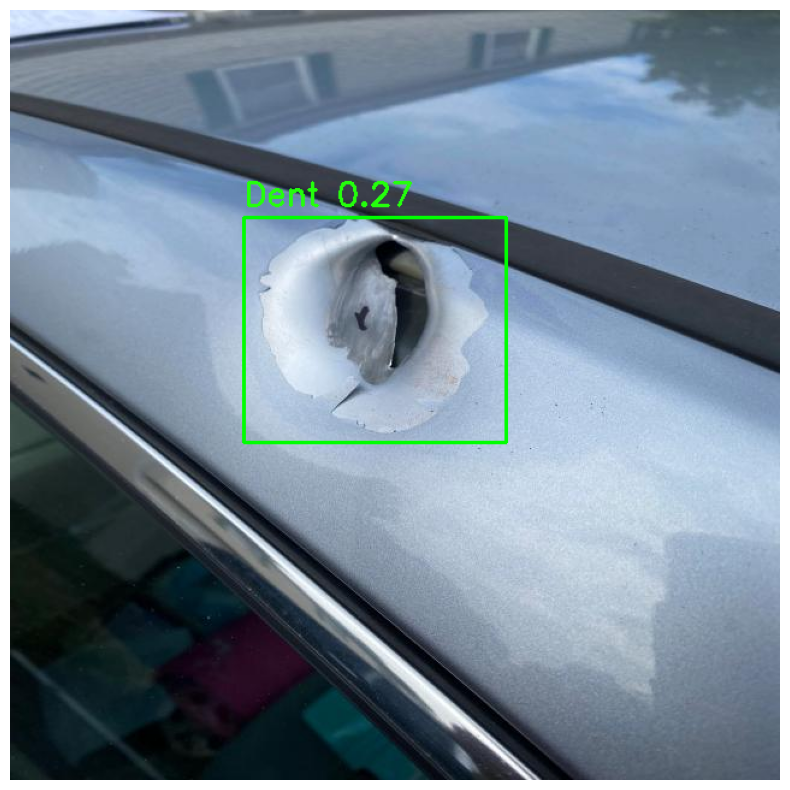


0: 640x640 1 PDR-Dent, 38.5ms
Speed: 3.0ms preprocess, 38.5ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 640)


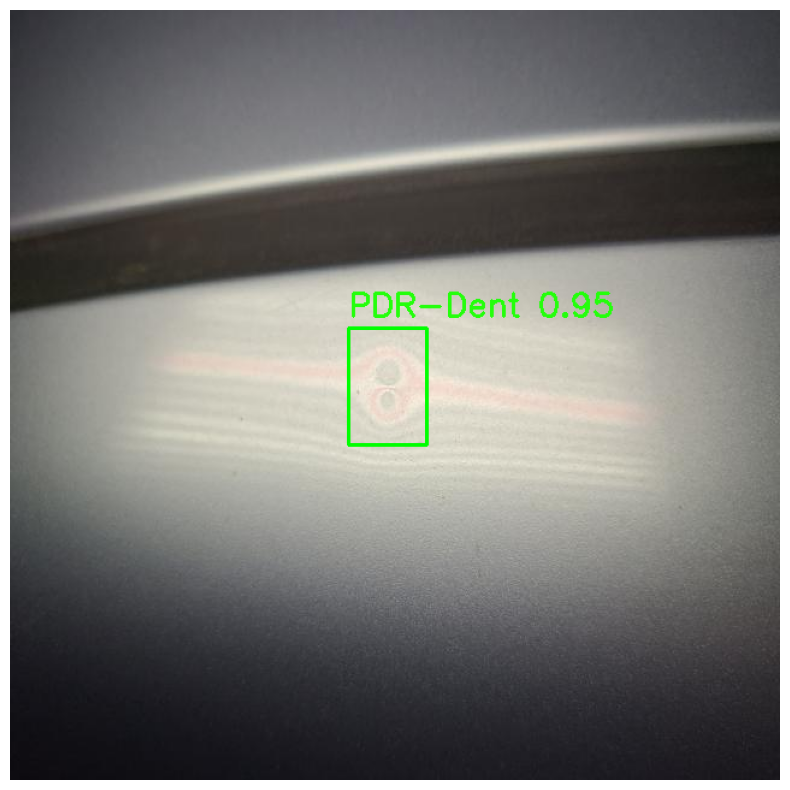


0: 640x640 1 Paint-fading, 38.4ms
Speed: 2.7ms preprocess, 38.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


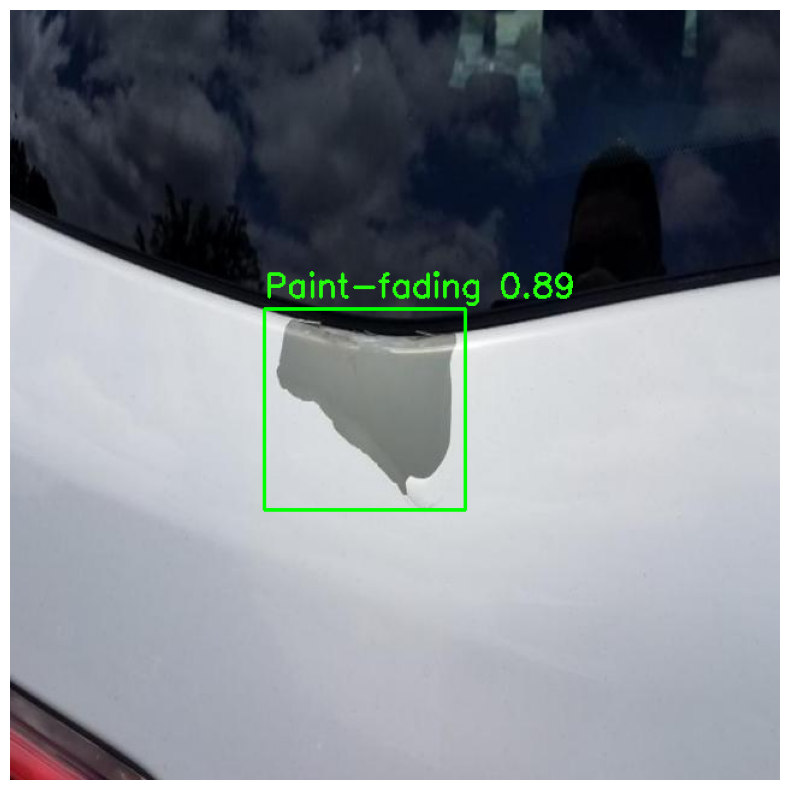


0: 640x640 1 PDR-Dent, 36.3ms
Speed: 2.6ms preprocess, 36.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)


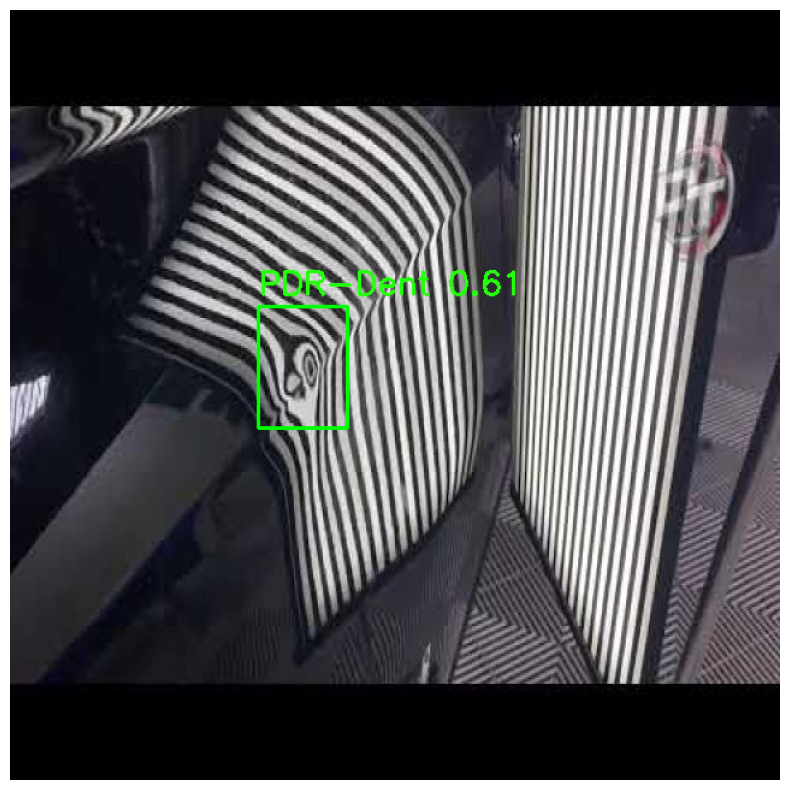

In [ ]:
# Load the model
model = YOLO('/content/runs/detect/train/weights/best.pt')

# Update the path to the test image directory
directory = data['test']

# Set the confidence threshold for predictions
confidence_threshold = 0.25

# Get a list of all the image files in the directory
image_files = [f for f in os.listdir(directory) if f.endswith('.jpg') or f.endswith('.png')]

# For each image file
for image_file in image_files:
    # Load the image
    img = cv2.imread(os.path.join(directory, image_file))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convert from BGR to RGB

    # Predict the objects in the image
    results = model.predict(img)

    # Check if there are any results and process the first Results object
    if len(results) > 0:
        result = results[0]

        # Access the boxes attribute, ensure it is transferred to CPU and converted to numpy
        if hasattr(result, 'boxes') and result.boxes:
            detections = result.boxes.data.cpu().numpy()  # Transfer to CPU and convert to numpy

            # Iterate over each detection
            for detection in detections:
                conf = detection[4]  # Get the confidence score
                if conf > confidence_threshold:
                    x1, y1, x2, y2 = map(int, detection[:4])
                    label = result.names[int(detection[5])]

                    # Draw the bounding box and label on the image
                    cv2.rectangle(img, (x1, y1), (x2, y2), (0, 255, 0), 2)
                    cv2.putText(img, f"{label} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36, 255, 12), 2)

    # Show the image using matplotlib
    plt.figure(figsize=(12, 10))
    plt.imshow(img)
    plt.axis('off')
    plt.show()


In [ ]:
# Zip the output directory
!zip -r /content/runs.zip ./runs

  adding: runs/ (stored 0%)
  adding: runs/detect/ (stored 0%)
  adding: runs/detect/train/ (stored 0%)
  adding: runs/detect/train/weights/ (stored 0%)
  adding: runs/detect/train/weights/last.pt (deflated 8%)
  adding: runs/detect/train/weights/best.pt (deflated 8%)
  adding: runs/detect/train/val_batch0_labels.jpg (deflated 9%)
  adding: runs/detect/train/train_batch0.jpg (deflated 3%)
  adding: runs/detect/train/F1_curve.png (deflated 6%)
  adding: runs/detect/train/val_batch2_labels.jpg (deflated 7%)
  adding: runs/detect/train/results.csv (deflated 61%)
  adding: runs/detect/train/train_batch1890.jpg (deflated 9%)
  adding: runs/detect/train/train_batch1892.jpg (deflated 12%)
  adding: runs/detect/train/args.yaml (deflated 53%)
  adding: runs/detect/train/labels_correlogram.jpg (deflated 40%)
  adding: runs/detect/train/confusion_matrix_normalized.png (deflated 20%)
  adding: runs/detect/train/train_batch2.jpg (deflated 3%)
  adding: runs/detect/train/val_batch1_pred.jpg (deflate

In [ ]:
# After training
results = model.train(data='data.yaml', epochs=20)

# To evaluate and print accuracy metrics
metrics = model.val()  # Run validation
print(f"mAP50: {metrics.box.map50:.4f}")
print(f"mAP50-95: {metrics.box.map:.4f}")

Ultralytics 8.3.161 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=20, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=/content/runs/detect/train/weights/best.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12

train: Scanning /content/train/labels.cache... 342 images, 0 backgrounds, 0 corrupt: 100%|██████████| 342/342 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 644.6±325.5 MB/s, size: 36.5 KB)


val: Scanning /content/valid/labels.cache... 69 images, 0 backgrounds, 0 corrupt: 100%|██████████| 69/69 [00:00<?, ?it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000909, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      6.21G      2.153      3.383      2.167         20        640: 100%|██████████| 22/22 [00:12<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         69        141      0.132      0.138     0.0671     0.0447



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20       6.5G      1.707      2.276      1.718         37        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         69        141      0.498      0.225      0.225      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      6.51G      1.475      1.992      1.546         16        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]

                   all         69        141      0.749      0.281      0.373      0.197



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      6.39G      1.378      1.739      1.476         40        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]

                   all         69        141        0.6       0.32      0.371      0.198



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20       6.4G      1.339      1.596      1.423         29        640: 100%|██████████| 22/22 [00:11<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]

                   all         69        141      0.503      0.457      0.459       0.23



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      6.56G      1.307       1.49      1.372         48        640: 100%|██████████| 22/22 [00:11<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.01it/s]

                   all         69        141      0.641      0.443       0.46       0.24



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      6.37G      1.263      1.505      1.391         23        640: 100%|██████████| 22/22 [00:11<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.94it/s]

                   all         69        141      0.667      0.461      0.523      0.253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      6.47G      1.219      1.394      1.341         21        640: 100%|██████████| 22/22 [00:11<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.02it/s]

                   all         69        141      0.693      0.479      0.519      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      6.39G      1.181      1.327      1.322         14        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.04it/s]

                   all         69        141      0.637      0.483      0.504      0.266



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      6.46G      1.136       1.26      1.282         21        640: 100%|██████████| 22/22 [00:11<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.01it/s]

                   all         69        141      0.531      0.541      0.523       0.28


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, method='weighted_average', num_output_channels=3), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      6.37G      1.102      1.279      1.299          6        640: 100%|██████████| 22/22 [00:12<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.85it/s]

                   all         69        141       0.56      0.411      0.458      0.233



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      6.45G      1.066      1.194      1.286          9        640: 100%|██████████| 22/22 [00:11<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]

                   all         69        141      0.704      0.415       0.49       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      6.36G      1.029      1.097      1.244         16        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]

                   all         69        141      0.806      0.479      0.535      0.293



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      6.46G     0.9947      1.047      1.221          9        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.00it/s]

                   all         69        141      0.748       0.49      0.531        0.3



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      6.42G     0.9691     0.9533      1.195          9        640: 100%|██████████| 22/22 [00:11<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.01it/s]

                   all         69        141      0.661      0.537       0.55      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      6.47G      0.941     0.9434      1.172         23        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.00it/s]

                   all         69        141      0.745      0.467      0.555      0.311



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      6.39G     0.9402     0.9023      1.198         25        640: 100%|██████████| 22/22 [00:11<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.01it/s]

                   all         69        141      0.659      0.496      0.538      0.323



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      6.46G     0.9026     0.8717      1.161          9        640: 100%|██████████| 22/22 [00:11<00:00,  1.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         69        141      0.737      0.496      0.545      0.324



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20      6.37G     0.8698     0.8078      1.116          6        640: 100%|██████████| 22/22 [00:11<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.96it/s]

                   all         69        141       0.66      0.519      0.573      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20      6.48G     0.8369     0.7991      1.112          9        640: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         69        141       0.73      0.495       0.58      0.333



20 epochs completed in 0.081 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 52.0MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.161 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,843,813 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]


                   all         69        141      0.725      0.492      0.575      0.333
                 Crack          7         15       0.61      0.267      0.337      0.234
                  Dent         10         10          1       0.69      0.786      0.567
              PDR-Dent         13         15      0.808      0.733      0.868      0.396
           Paint-Crack          5          6      0.663      0.333      0.407      0.194
          Paint-fading         15         29      0.692      0.517      0.607      0.405
                  Rust          9         18      0.556      0.444       0.51      0.269
               Scratch         20         48      0.747      0.458      0.511      0.266
Speed: 0.2ms preprocess, 10.0ms inference, 0.1ms loss, 2.4ms postprocess per image
Results saved to runs/detect/train2
Ultralytics 8.3.161 🚀 Python-3.11.13 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 92 layers, 25,843,813 parameters, 0 gradients, 78.7 GFLOPs
val:

val: Scanning /content/valid/labels.cache... 69 images, 0 backgrounds, 0 corrupt: 100%|██████████| 69/69 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 5/5 [00:02<00:00,  1.68it/s]


                   all         69        141      0.729      0.494       0.58      0.333
                 Crack          7         15      0.609      0.267      0.337      0.231
                  Dent         10         10          1      0.685      0.786      0.564
              PDR-Dent         13         15      0.808      0.733       0.87      0.395
           Paint-Crack          5          6      0.662      0.333      0.409      0.195
          Paint-fading         15         29      0.692      0.517      0.607      0.405
                  Rust          9         18      0.553      0.444      0.511       0.27
               Scratch         20         48      0.781      0.479      0.541       0.27
Speed: 3.6ms preprocess, 23.7ms inference, 0.0ms loss, 5.5ms postprocess per image
Results saved to runs/detect/train22
mAP50: 0.5801
mAP50-95: 0.3328
